In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import regex as reg
# from mpl_toolkits.basemap import Basemap
from networkx.algorithms.community import greedy_modularity_communities
from matplotlib.colors import ListedColormap
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

In [2]:
from wordcloud import WordCloud

In [3]:
import plotly.plotly as py
import plotly.graph_objs as go
from plotly import tools
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode()

Loading the data about universities:

In [4]:
universities = pd.read_pickle('data/Universities.pkl')
universities.head()

,file,name,domain,email,author_order,country,Lat,Lon
0,2018_import_480,University of Colorado at Boulder,colorado.edu,jeffrey.bush@colorado.edu,0,United States,40.006667,-105.267222
1,2018_import_480,Woot Math Inc.,wootmath.com,brent.milne@wootmath.com,1,NaN,NaN,NaN
2,2018_import_494,Indiana University,iu.edu,davis217@umail.iu.edu,0,United States,39.166667,-86.500000
3,2018_import_494,Indiana University,iu.edu,tuxi@umail.iu.edu,1,United States,39.166667,-86.500000
4,2018_import_494,Indiana University at Bloomington,indiana.edu,jdanish@indiana.edu,2,United States,39.167222,-86.521389


In [5]:
universities.rename(columns={'email': 'mail'}, inplace=True)

In [6]:
universities['merge_index'] = universities.apply(lambda x: x['file']+str(x['author_order']), axis=1)

metadata = pd.read_csv('data/Parsed_metadata.csv', index_col=0, parse_dates=['accessioned', 'available', 'issued'])
metadata.issued = metadata.issued.map(lambda x: x.year)
metadata['merge_index'] = metadata.apply(lambda x: x['file']+str(x['author_order']), axis=1)
associations = pd.merge(universities, metadata, on='merge_index')

In [7]:
associations.rename(columns={'file_x': 'file'}, inplace=True)

In [8]:
metadata.sort_values(by ='file')

,file,subject,iso,uri,type,publisher,title,issued,accessioned,citation,available,abstract,long_name,author_order,shortend_names,identifier,merge_index
164,2015_import_105,"['music', 'intuitions', 'social negotiation']",en,https://doi.dx.org/10.22318/cscl2015.105,Book chapter,International Society of the Learning Science...,“That’s What Everyone Else Is Saying…”: Collab...,2015,2017-06-19 14:15:51,"Downton, M. P. (2015). “That’s What Everyone E...",2017-06-19 14:15:51,With the progression of more user-friendly mus...,"Downton, Michael P.",0,Downton M. P.,"Downton, M. P. (2015). “That’s What Everyone E...",2015_import_1050
799,2015_import_122,"['orchestration', 'discourse', 'inquiry', 'col...",en,https://doi.dx.org/10.22318/cscl2015.122,Book chapter,International Society of the Learning Science...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Cober, Rebecca",1,Cober R.,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2015_import_1221
335,2015_import_122,"['orchestration', 'discourse', 'inquiry', 'col...",en,https://doi.dx.org/10.22318/cscl2015.122,Book chapter,International Society of the Learning Science...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Fong, Cresencia",0,Fong C.,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2015_import_1220
1455,2015_import_122,"['orchestration', 'discourse', 'inquiry', 'col...",en,https://doi.dx.org/10.22318/cscl2015.122,Book chapter,International Society of the Learning Science...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Peebles, Ben",5,Moher T.,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2015_import_1225
1553,2015_import_122,"['orchestration', 'discourse', 'inquiry', 'col...",en,https://doi.dx.org/10.22318/cscl2015.122,Book chapter,International Society of the Learning Science...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Murray, Julia",4,Messina R.,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2015_import_1224
1615,2015_import_122,"['orchestration', 'discourse', 'inquiry', 'col...",en,https://doi.dx.org/10.22318/cscl2015.122,Book chapter,International Society of the Learning Science...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Slotta, James D.",6,Moher T.,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2015_import_1226
1361,2015_import_122,"['orchestration', 'discourse', 'inquiry', 'col...",en,https://doi.dx.org/10.22318/cscl2015.122,Book chapter,International Society of the Learning Science...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Moher, Tom",3,Messina R.,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2015_import_1223
1145,2015_import_122,"['orchestration', 'discourse', 'inquiry', 'col...",en,https://doi.dx.org/10.22318/cscl2015.122,Book chapter,International Society of the Learning Science...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Messina, Richard",2,Cober R.,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2015_import_1222
151,2015_import_126,"['principle-based', 'adaptive teaching',

In [9]:
#associations[['file', 'title', 'long_name', 'author_order_y', 'shortend_names']].to_csv('author_data.csv', index=False)

In [10]:
associations.sort_values(by =['file', 'author_order_y']).head(10)

,file,name,domain,mail,author_order_x,country,Lat,Lon,merge_index,file_y,...,title,issued,accessioned,citation,available,abstract,long_name,author_order_y,shortend_names,identifier
1228,2015_import_105,Saint John's University (NY),stjohns.edu,downtonm@stjohns.edu,0,United States,40.729944,-73.990073,2015_import_1050,2015_import_105,...,“That’s What Everyone Else Is Saying…”: Collab...,2015,2017-06-19 14:15:51,"Downton, M. P. (2015). “That’s What Everyone E...",2017-06-19 14:15:51,With the progression of more user-friendly mus...,"Downton, Michael P.",0,Downton M. P.,"Downton, M. P. (2015). “That’s What Everyone E..."
681,2015_import_122,University of Toronto,utoronto.ca,cresencia.fong@utoronto.ca,0,Canada,43.661667,-79.395000,2015_import_1220,2015_import_122,...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Fong, Cresencia",0,Fong C.,"Fong, C., Cober, R., Messina, R., Moher, T., M..."
682,2015_import_122,University of Toronto,utoronto.ca,rebecca.cober@utoronto.ca,1,Canada,43.661667,-79.395000,2015_import_1221,2015_import_122,...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Cober, Rebecca",1,Cober R.,"Fong, C., Cober, R., Messina, R., Moher, T., M..."
683,2015_import_122,University of Toronto,utoronto.ca,richard.messina@utoronto.ca,2,Canada,43.661667,-79.395000,2015_import_1222,2015_import_122,...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Messina, Richard",2,Cober R.,"Fong, C., Cober, R., Messina, R., Moher, T., M..."
684,2015_import_122,University of Illinois at Chicago,uic.edu,moher@uic.edu,3,United States,41.871667,-87.649167,2015_import_1223,2015_import_122,...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Moher, Tom",3,Messina R.,"Fong, C., Cober, R., Messina, R., Moher, T., M..."
685,2015_import_122,University of Toronto,utoronto.ca,julia.murraye@utoronto.ca,4,Canada,43.661667,-79.395000,2015_import_1224,2015_import_122,...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Murray, Julia",4,Messina R.,"Fong, C., Cober, R., Messina, R., Moher, T., M..."
686,2015_import_122,University of Toronto,utoronto.ca,ben.peebles@utoronto.ca,5,Canada,43.661667,-79.395000,2015_import_1225,2015_import_122,...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Peebles, Ben",5,Moher T.,"Fong, C., Cober, R., Messina, R., Moher, T., M..."
687,2015_import_122,University of Toronto,utoronto.ca,jslotta@oise.utoronto.ca,6,Canada,43.661667,-79.395000,2015_import_1226,2015_import_122,...,The 3R Orchestration Cycle: Fostering Multi-Mo...,2015,2017-06-19 14:15:51,"Fong, C., Cober, R., Messina, R., Moher, T., M...",2017-06-19 14:15:51,This paper reports on second and third iterati...,"Slotta, James D.",6,Moher T.,"Fong, C., Cober, R., Messina, R., Moher, T., M..."
791,2015_import_126,National Chengchi University,nccu.edu.tw,hyhong@nccu.edu.tw,0,Taiwan,24.986992,121.575222,2015_import_1260,2015_import_126,...,Principle-Based Guidance to Foster Adaptive Te...,2015,2017-06-19 14:15:51,"Hong, H., Chai, C. S., & Hung, G. (2015). Prin...",2017-06-19 14:15:51,This exploratory study investigated the effect...,"Hong, Huang-Yao",0,Hong H.,"Hong, H., Chai, C. S., & Hung,

# Looking at co authorship, taking into consideration country and inst.

We use the associations frame again to build a co-authorship graph based on people with attributes country and institution

In [11]:
print(associations.columns)
#we can drop one of the file columns
(associations.file != associations.file_y).sum()

Index(['file', 'name', 'domain', 'mail', 'author_order_x', 'country', 'Lat',
       'Lon', 'merge_index', 'file_y', 'subject', 'iso', 'uri', 'type',
       'publisher', 'title', 'issued', 'accessioned', 'citation', 'available',
       'abstract', 'long_name', 'author_order_y', 'shortend_names',
       'identifier'],
      dtype='object')


0

In [12]:
associations['subject'] = associations.subject.map(lambda x: [reg.sub("'|,|\[|\]", '', y).lower().strip() for y in x.split(',')])

In [13]:
del associations['file_y']

In [14]:
associations = associations[associations.country.notna()]

In [15]:
self_merge = pd.merge(associations, associations, on='file')
self_merge = self_merge[self_merge.long_name_x != self_merge.long_name_y]

#edges = self_merge[['long_name_x', 'long_name_y', 'issued_x']].copy()

nodes = associations[~associations.long_name.duplicated()].reset_index(drop=True).reset_index()
name_index = nodes.long_name.to_dict()
name_index = {v: k for k, v in name_index.items()}

In [16]:
self_merge['source'] = self_merge.long_name_x.map(name_index)
self_merge['target'] = self_merge.long_name_y.map(name_index)

In [17]:
def get_adjacency(nodes, edges):
    n_nodes = len(nodes)
    adjacency = np.zeros((n_nodes, n_nodes), dtype=int)

    for idx, row in edges.iterrows():
        i, j = int(row.source), int(row.target)
        adjacency[i, j] += 1

    return adjacency

In [18]:
adjacency = get_adjacency(nodes, self_merge)
graph = nx.from_numpy_array(adjacency)

Adding attributes to the graph:

In [19]:
edge_dict = {}
keyword_dict = {}
for i, row in self_merge.iterrows():
    edge_dict[(row['source'], row['target'])] =  row['issued_x']
    keyword_dict[(row['source'], row['target'])] =  row['subject_x']

In [20]:
nx.set_edge_attributes(graph, edge_dict, name='year')
nx.set_edge_attributes(graph, keyword_dict, name='keywords')
nx.set_node_attributes(graph, nodes.country.to_dict(), name='country')
nx.set_node_attributes(graph, nodes.name.to_dict(), name='uni')
mapping = nodes.long_name.to_dict()

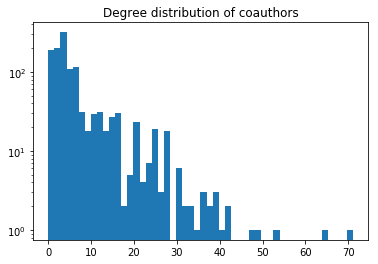

In [21]:
plt.title('Degree distribution of coauthors')
plt.hist(adjacency.sum(axis=1), bins=50, log=True)
plt.show()

Component sizes:

In [22]:
pd.Series([len(i) for i in list(nx.connected_components(graph))]).value_counts().sort_index()

1      45
2      53
3      37
4      22
5      20
6       9
7       8
8       2
9       2
10      1
11      2
13      1
21      1
24      1
35      1
511     1
dtype: int64

This is a simple drawing of our network: we see that there is a large core communit, and many many smaller comminitues of co authors. We will look more into the main community

In [23]:
#pos = nx.drawing.layout.kamada_kawai_layout(graph)

In [24]:
#pos = nx.layout.spring_layout(graph)
pos = nx.layout.fruchterman_reingold_layout(graph)

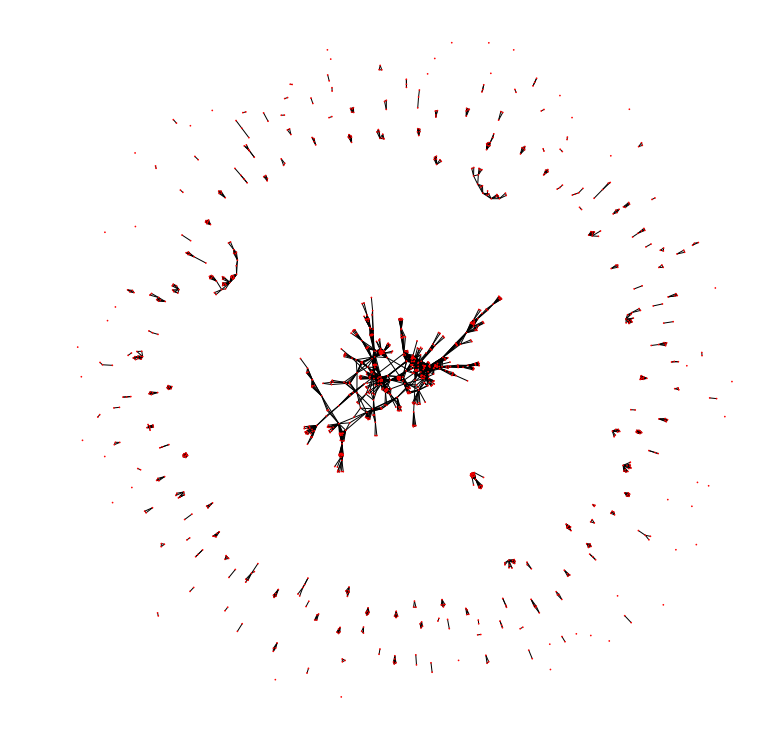

In [25]:
plt.figure(figsize=(10, 10))
nx.draw(graph, pos=pos, node_size=[0.5,0.5])

In [26]:
embedding = nodes.apply(lambda x: [x.Lon, x.Lat], axis=1)

In [27]:
weight = nx.get_edge_attributes(graph, 'weight')

We focus in on the different components:

In [28]:
#get components
largest_cc = max(nx.connected_components(graph), key=len)

The total number of components is:

In [29]:
nx.number_connected_components(graph)

206

In [30]:
print('the largest component contains : {} people'.format(len(largest_cc)))

the largest component contains : 511 people


Use centrality to highlight nodes that function as "bridges" between people

In [31]:
centrality = nx.betweenness_centrality(graph.subgraph(largest_cc))

In [32]:
np.quantile(np.array(list(centrality.values())), 0.9)

0.030089722903808416

In [33]:
lables = nodes['long_name'].to_dict()

lables = { key: lables[key] for (key, value) in centrality.items() if value > 0.03}

In [34]:
node_size = np.array(list(centrality.values()))*5000

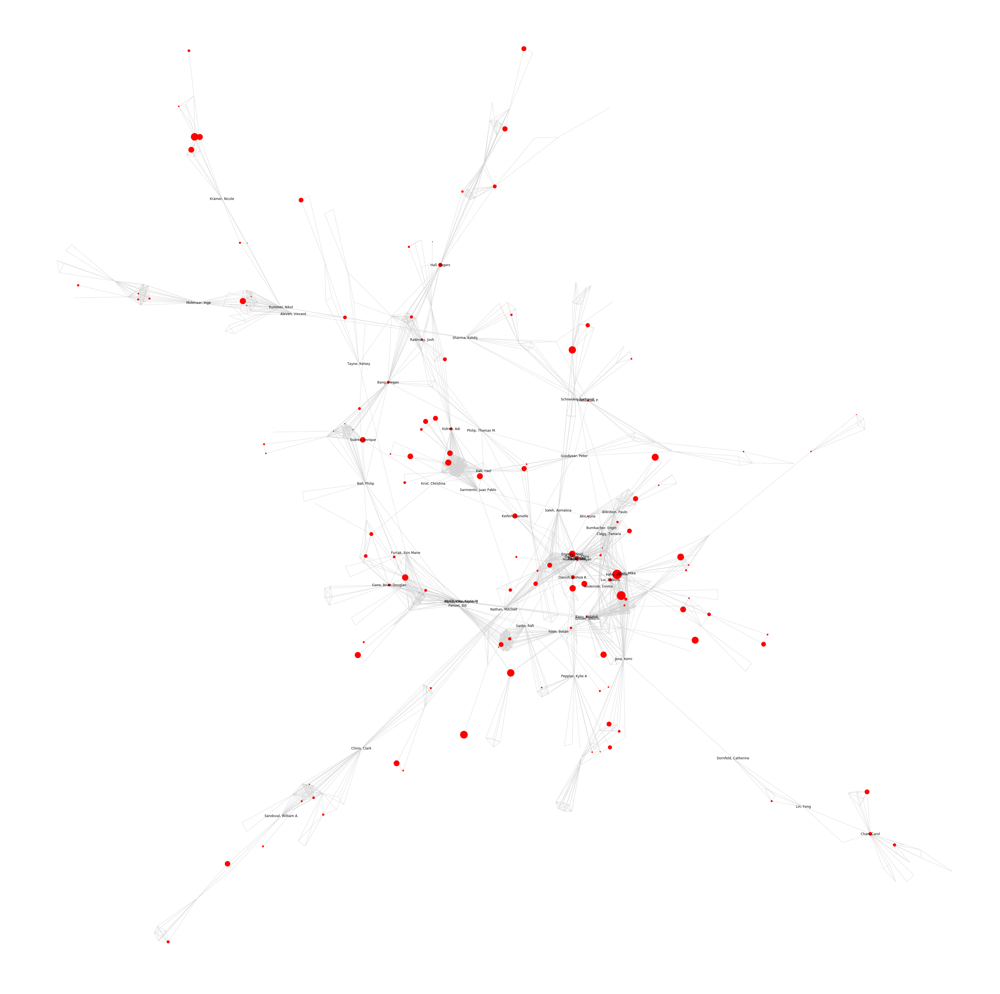

In [35]:
plt.figure(figsize=(50, 50))
nx.draw(graph.subgraph(largest_cc), node_size=node_size, edge_color='lightgray', labels=lables)

In [36]:
nx.average_shortest_path_length(graph.subgraph(largest_cc))

5.766424926134838

In [37]:
nx.average_clustering(graph.subgraph(largest_cc))

0.8481684983938462

In [38]:
nx.density(graph.subgraph(largest_cc))

0.019730631978818924

**Same graph for people who collaborated at least on 3 papers:**

e.g. we look at frequent collaborators (also forming a main component)

In [39]:
G = nx.Graph(((source, target, attr) for source, target, attr in graph.edges(data=True) if attr['weight'] > 1))
nx.set_node_attributes(G, nodes.country.to_dict(), name='country')
nx.set_node_attributes(G, nodes.name.to_dict(), name='uni')
nx.set_node_attributes(G, nodes.long_name.to_dict(), name='author')

largest_ccs = [i for i in nx.connected_components(G) if len(i) > 4 and len(i) < 20]#if len(i) > 9 and len(i) < 20]
len(largest_ccs)

6

In [40]:
[len(i) for i in largest_ccs]

[5, 7, 7, 6, 5, 5]

In [41]:
lc = max(nx.connected_components(G), key=len)

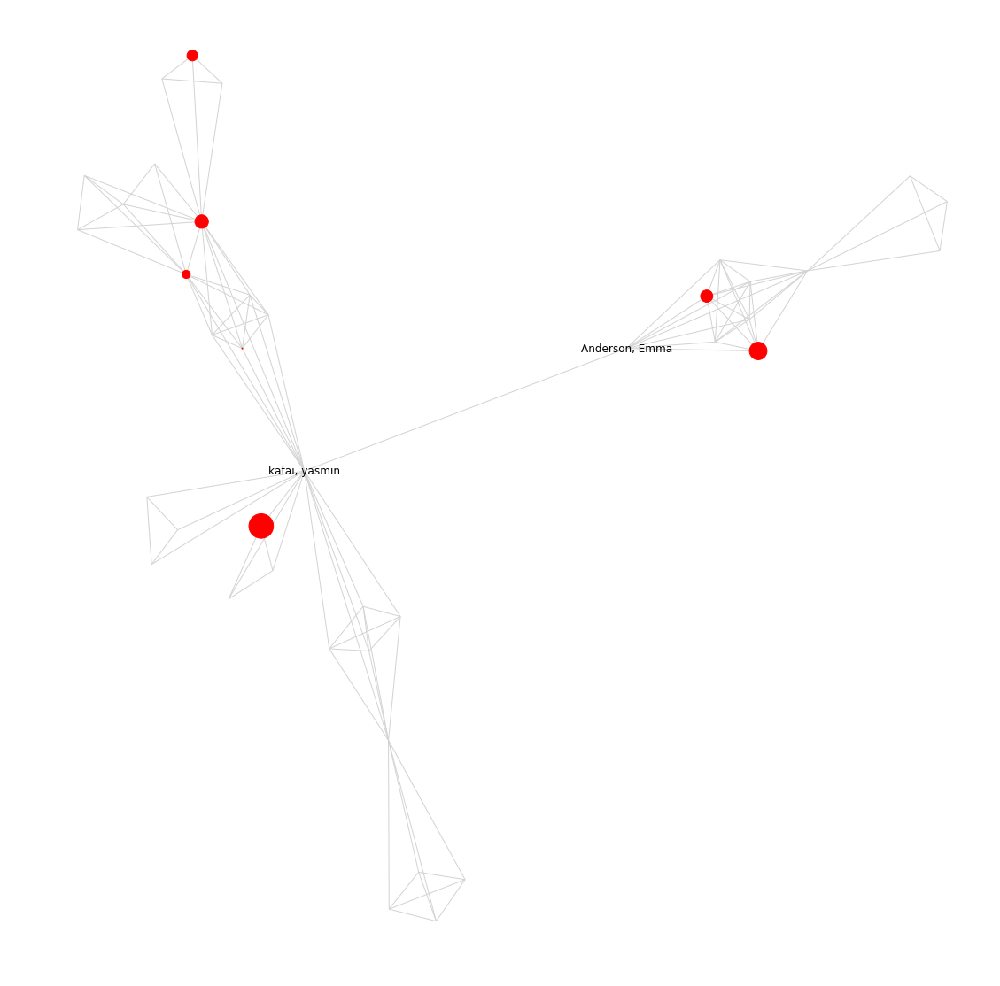

In [42]:
core = nx.k_core(G.subgraph(lc), k=3)
core = core.subgraph(max(nx.connected_components(core), key=len))
node_size = pd.Series(nx.betweenness_centrality(core))
labels = nx.get_node_attributes(core.subgraph(node_size[node_size.quantile(0.95) < node_size].index), 'author')
plt.figure(figsize=(15, 15))
pos= nx.layout.spring_layout(core)
nx.draw(core,pos=pos, edge_color='lightgray', node_size=node_size*1000, span=0.01, labels=labels, seed=2)
plt.savefig('figures/author_collab_large')

In [43]:
pd.Series(nx.get_node_attributes(core, 'country')).value_counts().shape

(2,)

In [44]:
palette = sns.color_palette(palette="tab20c_r", n_colors=20).as_hex()

In [45]:
core = nx.k_core(G.subgraph(lc), k=3)
core = core.subgraph(max(nx.connected_components(core), key=len))
node_size = pd.Series(nx.betweenness_centrality(core))


helper = sorted(list(set(nx.get_node_attributes(core, 'country').values())))
labels = nx.get_node_attributes(core.subgraph(node_size[node_size.quantile(0.92) < node_size].index), 'author')
node_color = [palette[helper.index(i)] for i in nx.get_node_attributes(core, 'country').values()]

In [46]:
import matplotlib.patches as mpatches

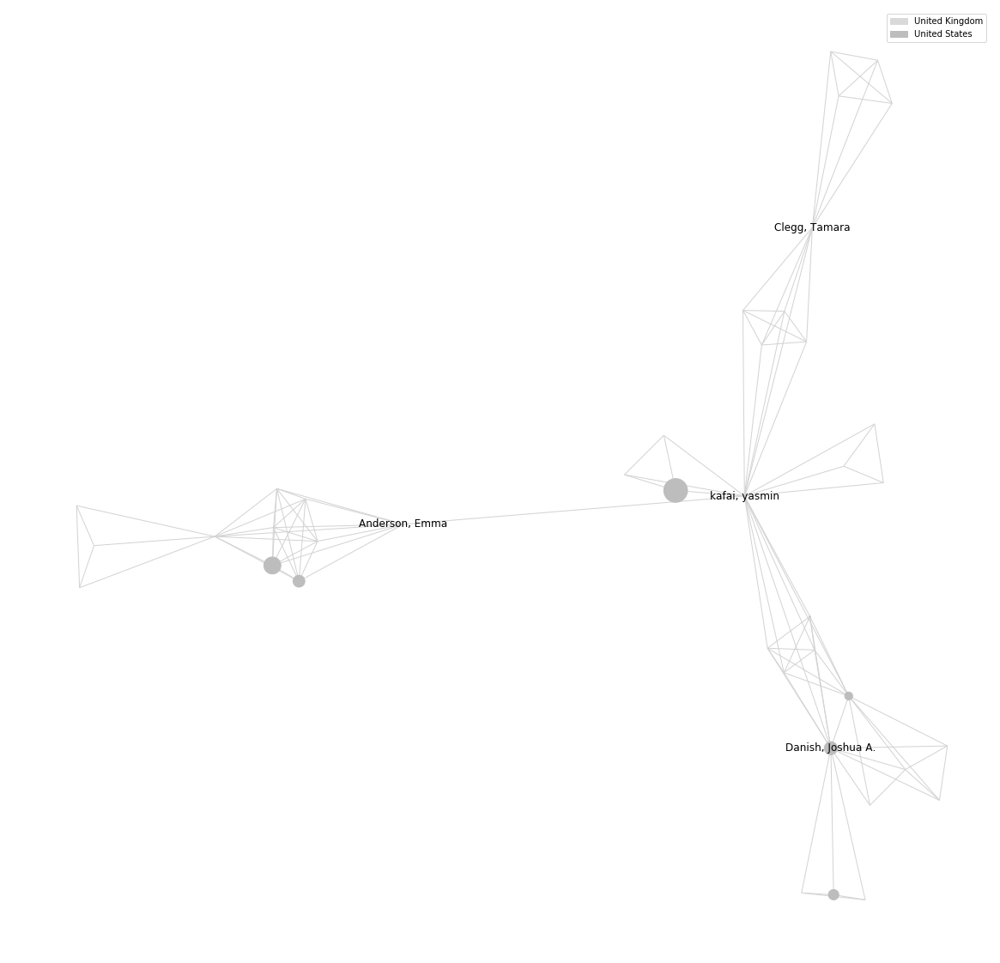

In [47]:
plt.figure(figsize=(20, 20))
    
#draw legend
legend = []
for ind, name in enumerate(helper):
    legend.append(mpatches.Patch(color=palette[ind], label=name))
plt.legend(handles=legend)

pos= nx.layout.spectral_layout(core)
pos = nx.layout.spring_layout(core, pos=pos, iterations=100)
nx.draw(core,pos=pos, edge_color='lightgray', node_size=node_size*1000, 
        span=0.01, labels=labels, node_color=node_color)
plt.savefig('figures/author_collab_large')

In [48]:
nx.write_gpickle(core, "core.gpickle")

In [49]:
from plotly import tools
from plotly.offline import iplot, init_notebook_mode

import plotly.plotly as py
from plotly.graph_objs import *

init_notebook_mode()

In [50]:
core = nx.read_gpickle("core.gpickle")

In [51]:
N = core.number_of_nodes()
nodes_ = core.nodes
E = core.edges.keys()

Xv=[pos[k][0] for k in nodes_]
Yv=[pos[k][1] for k in nodes_]

Xed=[]
Yed=[]
for edge in E:
    Xed+=[pos[edge[0]][0],pos[edge[1]][0], None]
    Yed+=[pos[edge[0]][1],pos[edge[1]][1], None] 
    
trace3=Scatter(x=Xed,
               y=Yed,
               mode='lines',
               line=dict(color='rgb(210,210,210)', width=1),
               hoverinfo='none'
               )
trace4=Scatter(x=Xv,
               y=Yv,
               mode='markers',
               name='net',
               marker=dict(symbol='circle-dot',
                             size=node_size*50, 
                             color=pd.Series(node_color).tolist(),
                             line=dict(color='rgb(50,50,50)', width=0.5)
                             ),
               text=list(nx.get_node_attributes(core, 'author').values()),
               hoverinfo='text'
               )


data1=[trace3, trace4]


layout=Layout(title= "Core of university graph",
    font= dict(size=12),
    showlegend=False,
    autosize=False,
    width=700,
    height=700,      
    hovermode='closest',
    annotations=[
           dict(
           showarrow=False, 
            xref='paper',     
            yref='paper',     
            x=0,  
            y=-0.1,  
            xanchor='left',   
            yanchor='bottom',  
            font=dict(
            size=14 
            )     
            )
        ]          
    )


fig1=Figure(data=data1, layout=layout)
#fig1['layout']['annotations'][0]['text']=annot

iplot(fig1, validate=False)

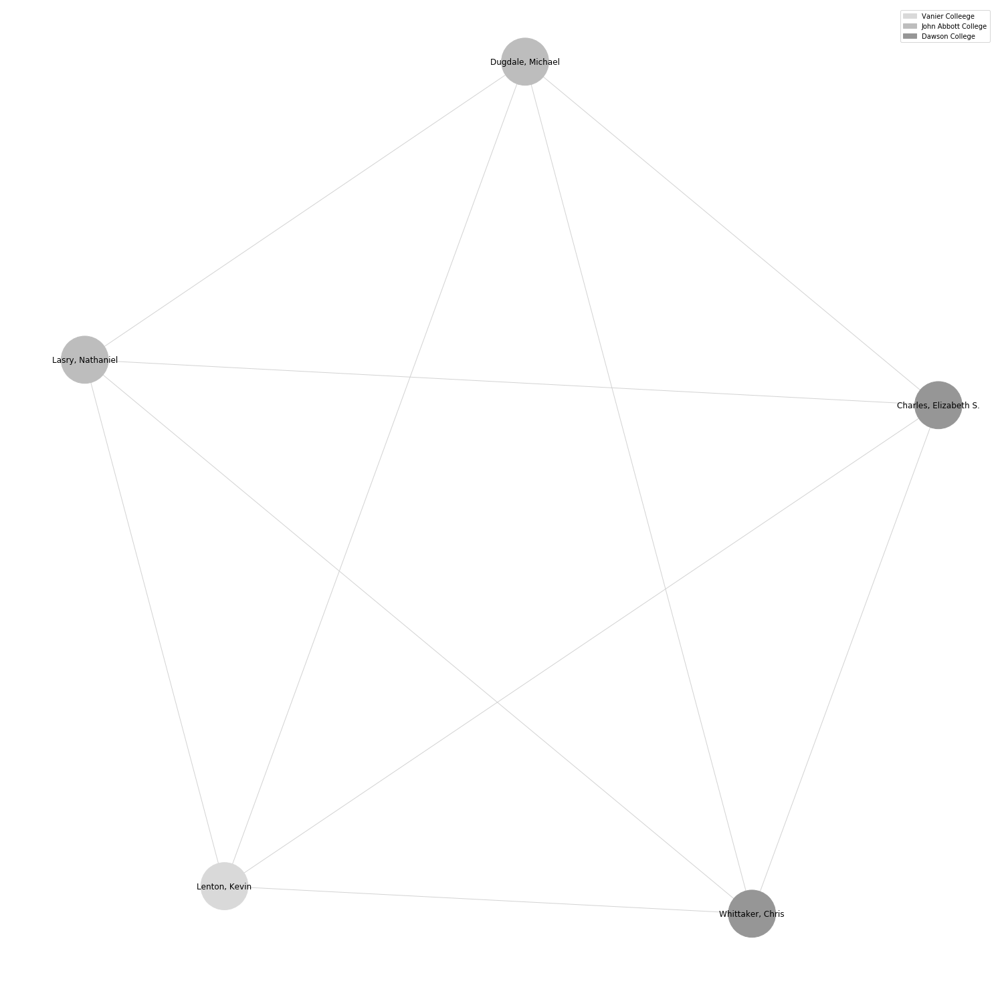

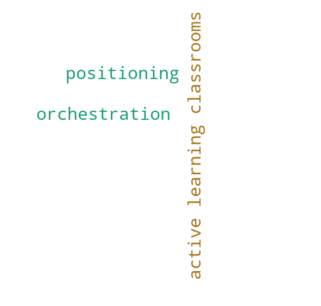

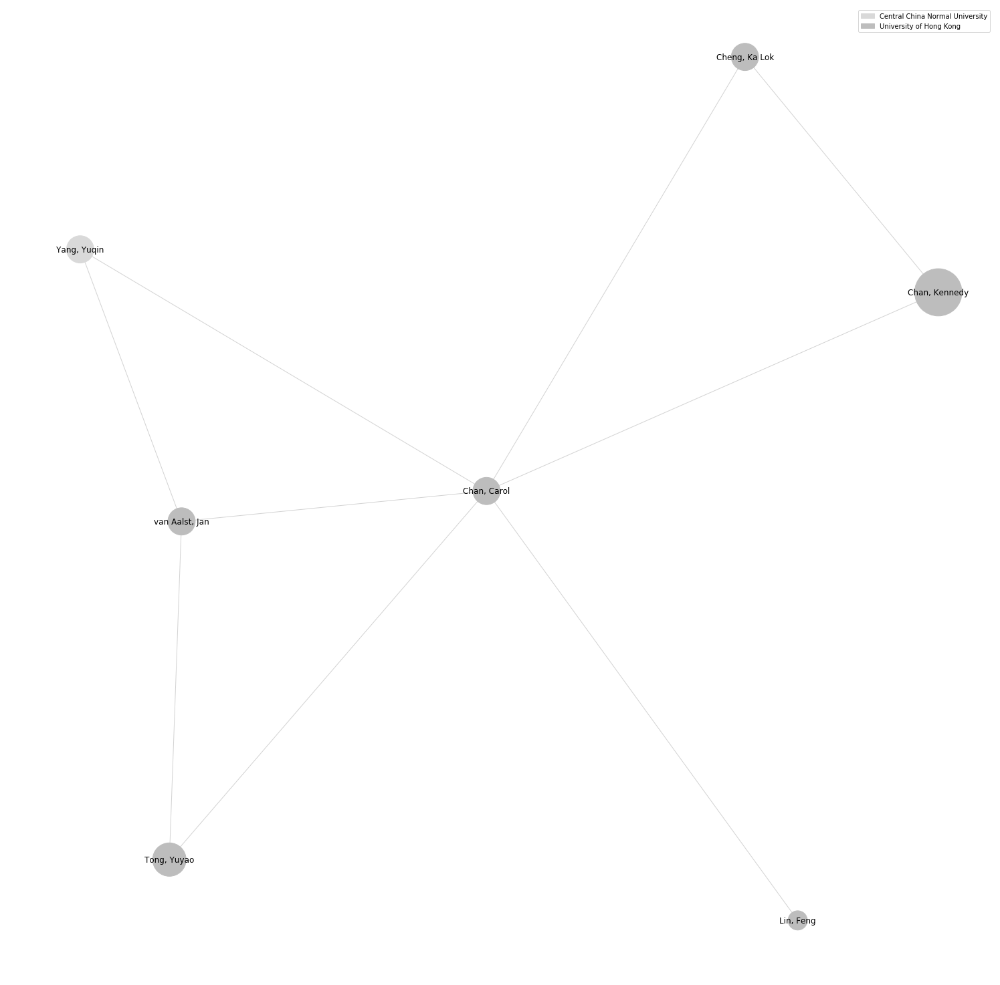

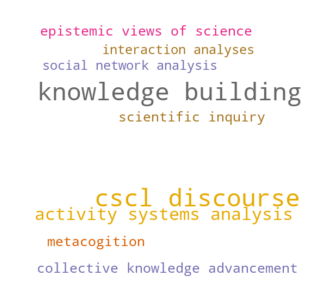

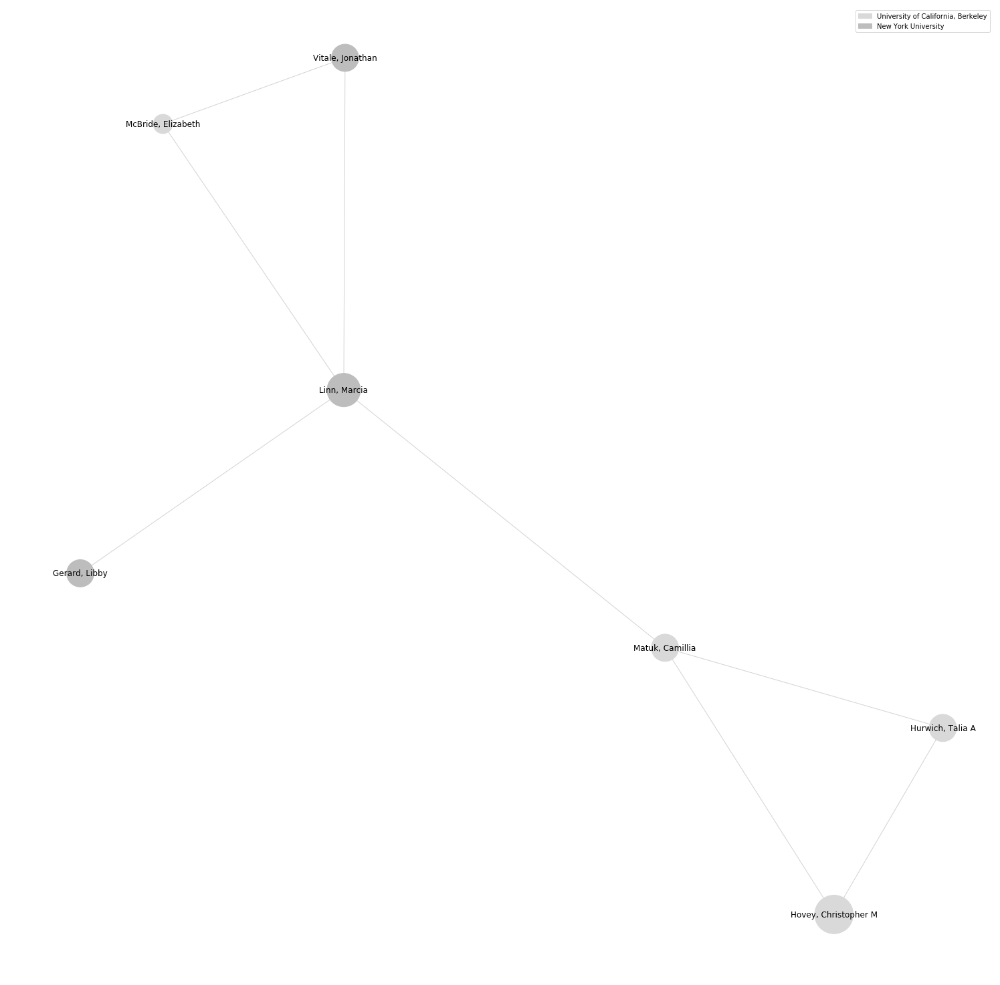

...

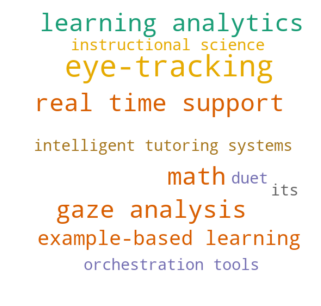

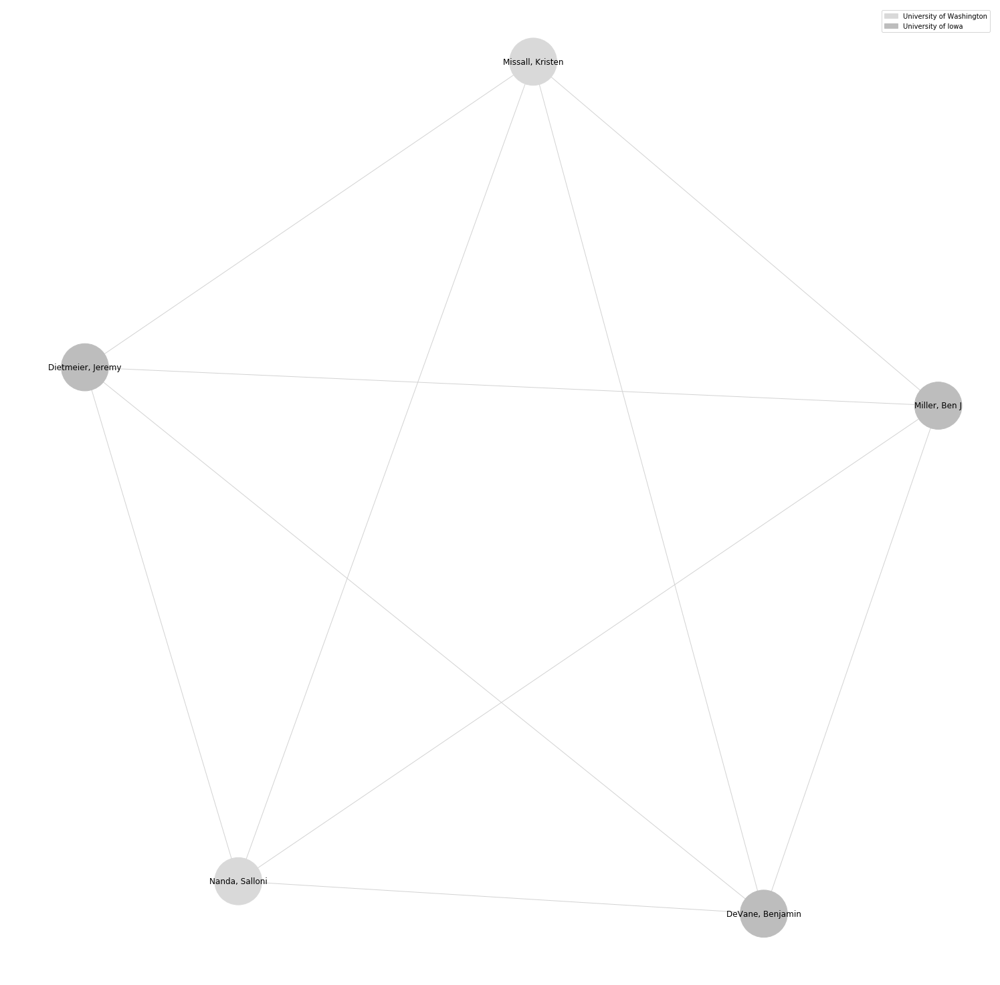

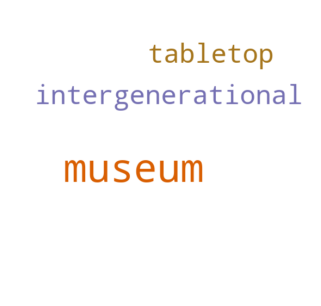

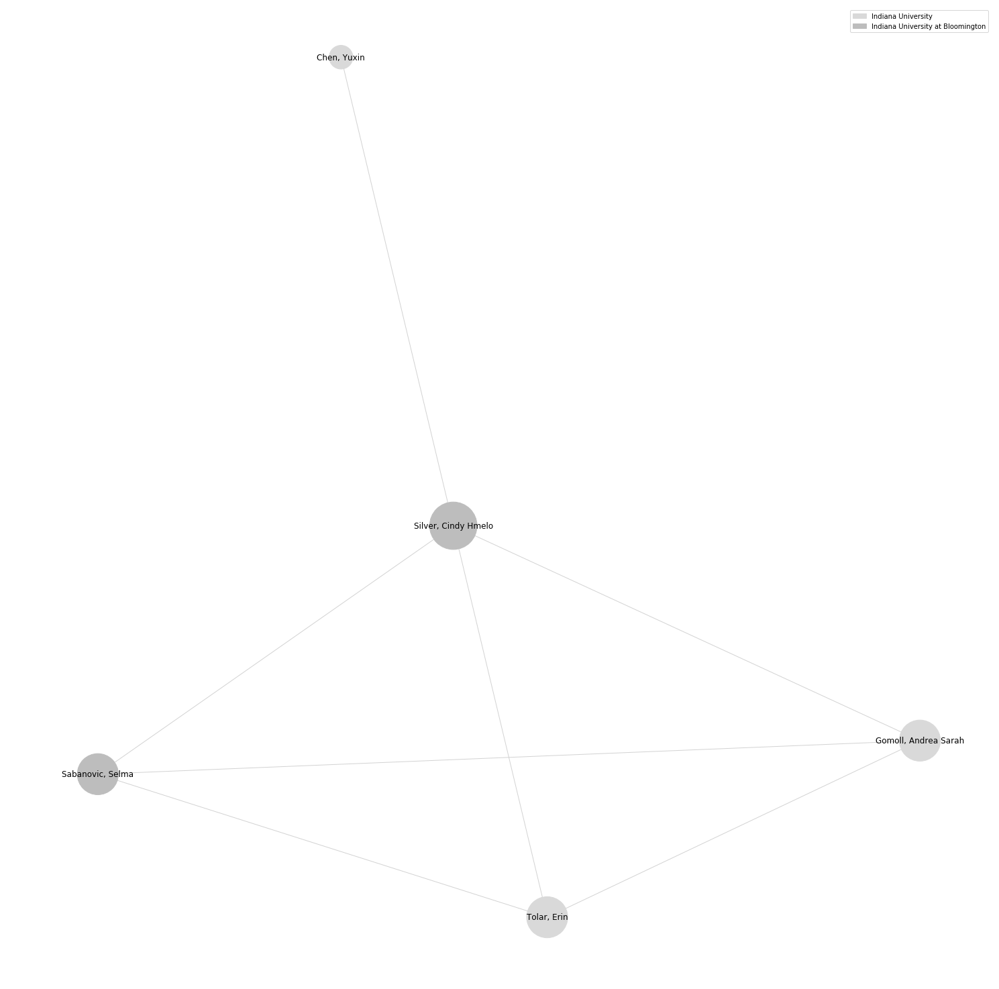

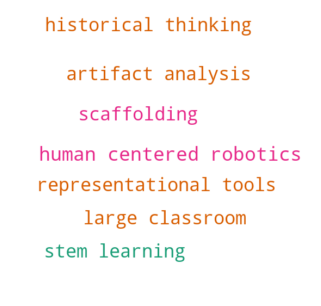

In [52]:
for largest_cc_strong in largest_ccs:
    
    helper = list(set(nx.get_node_attributes(
        G.subgraph(largest_cc_strong), 'uni').values()))
    node_color = [palette[helper.index(i)] for i in nx.get_node_attributes(G.subgraph(largest_cc_strong), 'uni').values()]
    
    plt.figure(figsize=(20, 20))
    
    node_size = np.array(list(nx.degree_centrality(G.subgraph(largest_cc_strong)).values()))

    lables = nodes.iloc[list(largest_cc_strong)]['long_name'].to_dict()
    nx.draw_spring(G.subgraph(largest_cc_strong), node_size=node_size*5000, labels=lables, edge_color='lightgray',
                  node_color=node_color)
    #draw legend
    legend = []
    for ind, name in enumerate(helper):
        legend.append(mpatches.Patch(color=palette[ind], label=name))
    plt.legend(handles=legend)
    
    plt.show()
    keywords = pd.Series(list(nx.get_edge_attributes(G.subgraph(largest_cc_strong), 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()

    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=keywords.shape[0], 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud.png', bbox_inches='tight')
    plt.show()

Drawing it in a geographical embedding:

#### Collaboration in the graph over the years:

In [53]:
edges = self_merge[['long_name_x', 'long_name_y', 'issued_x']].drop_duplicates()
counts = edges.groupby(['long_name_x', 'long_name_y']).count()
counts.issued_x.value_counts()

1    7390
2      92
Name: issued_x, dtype: int64

In [54]:
edge_dict = {}
keyword_dict = {}
for i, row in counts[counts.issued_x > 1].reset_index().iterrows():
    keywords = self_merge[(self_merge.long_name_x == row.long_name_x) & 
                     (self_merge.long_name_y == row.long_name_y)].subject_x
    keywords = [i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j if len(i) > 0]
    keyword_dict[(row.long_name_x, row.long_name_y)] = keywords

In [55]:
G = nx.from_pandas_edgelist(counts[counts.issued_x > 1].reset_index(), 
                        source='long_name_x', target='long_name_y', edge_attr=['issued_x'])
nx.set_node_attributes(G, nodes.set_index('long_name').country.to_dict(), name='country')
nx.set_node_attributes(G, nodes.set_index('long_name').name.to_dict(), name='uni')
nx.set_edge_attributes(G, keyword_dict, name='keywords')

In [56]:
palette = sns.color_palette(palette="tab20", n_colors=20).as_hex()

In [57]:
[len(i) for i in list(nx.connected_components(G)) if len(i) > 2]

[5, 5, 5, 4]

_______
subgraph 0
________


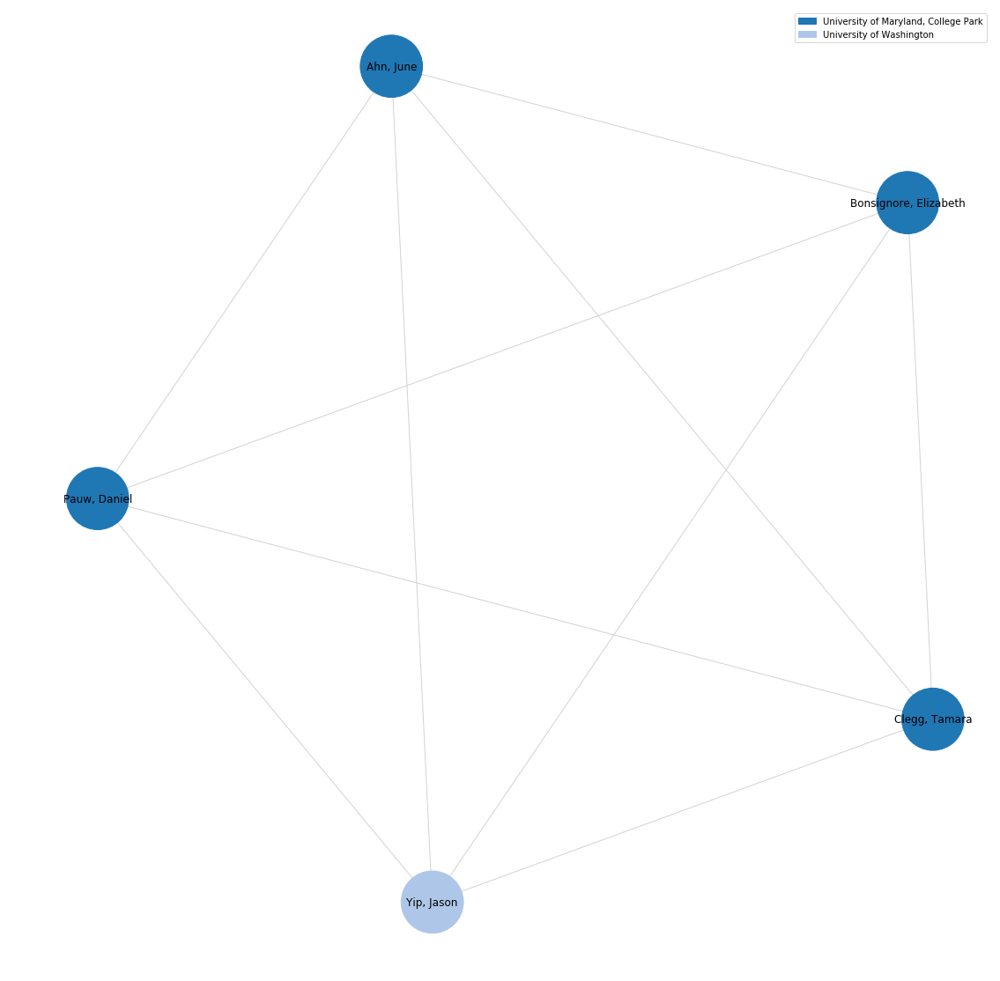

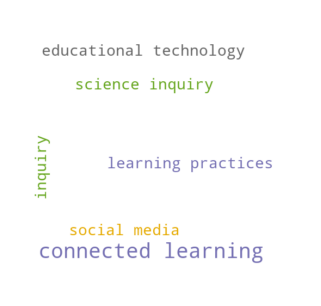

_______
subgraph 1
________


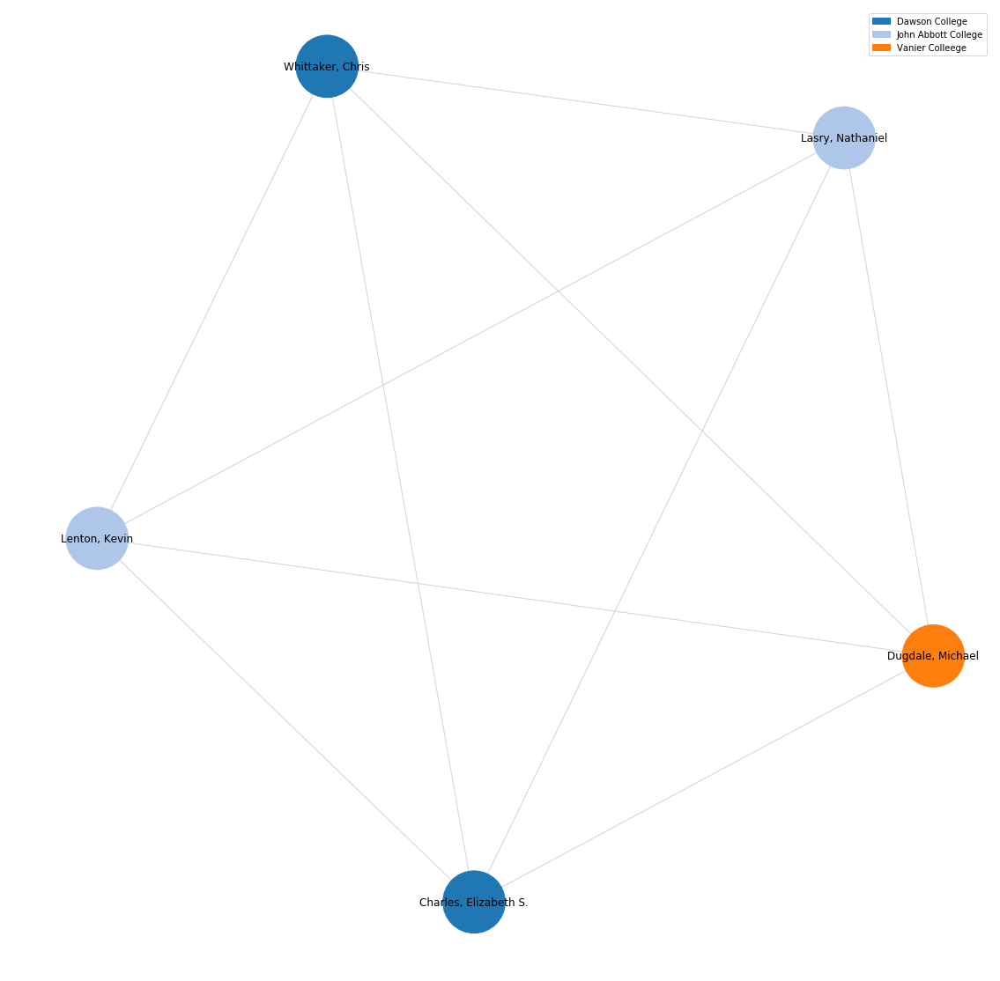

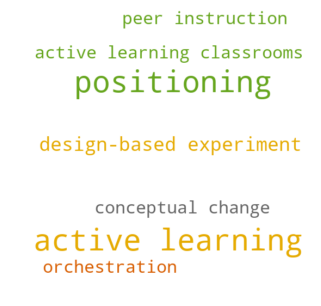

_______
subgraph 2
________


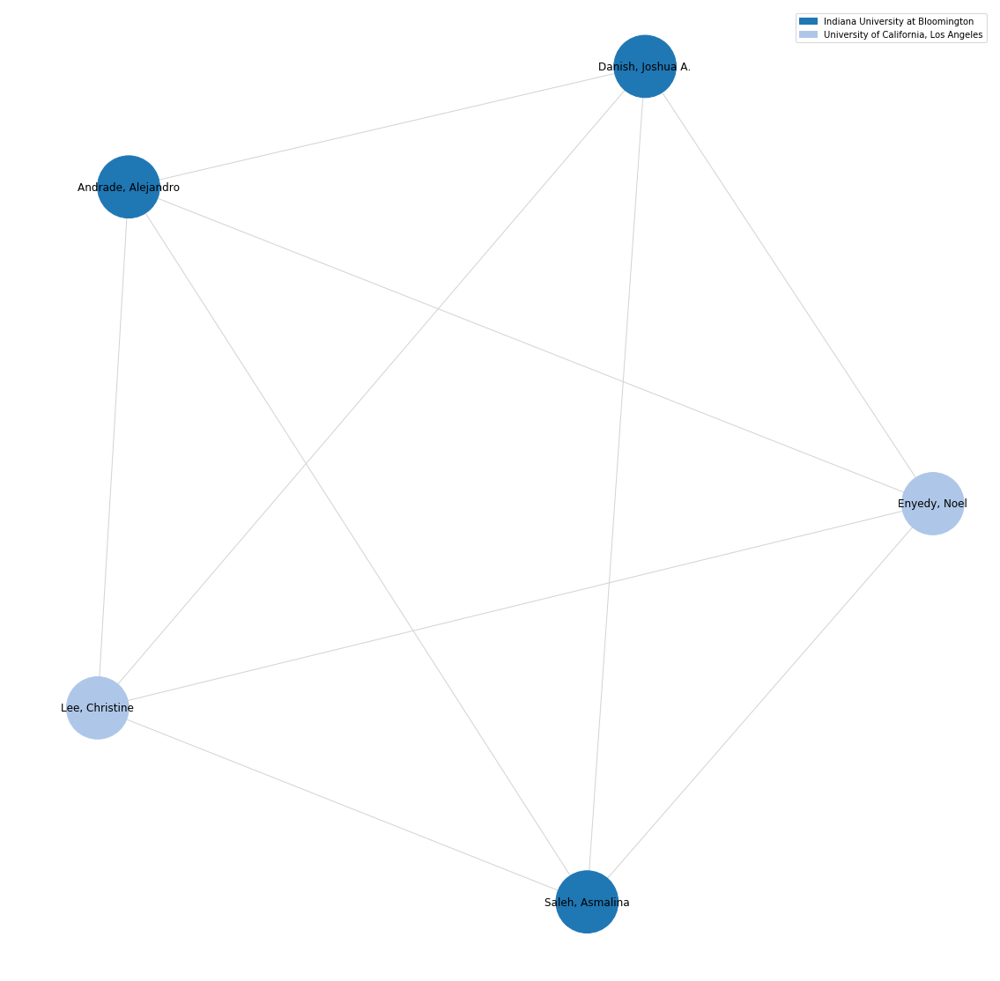

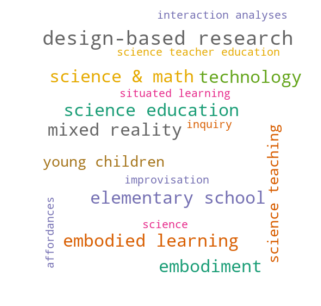

_______
subgraph 3
________


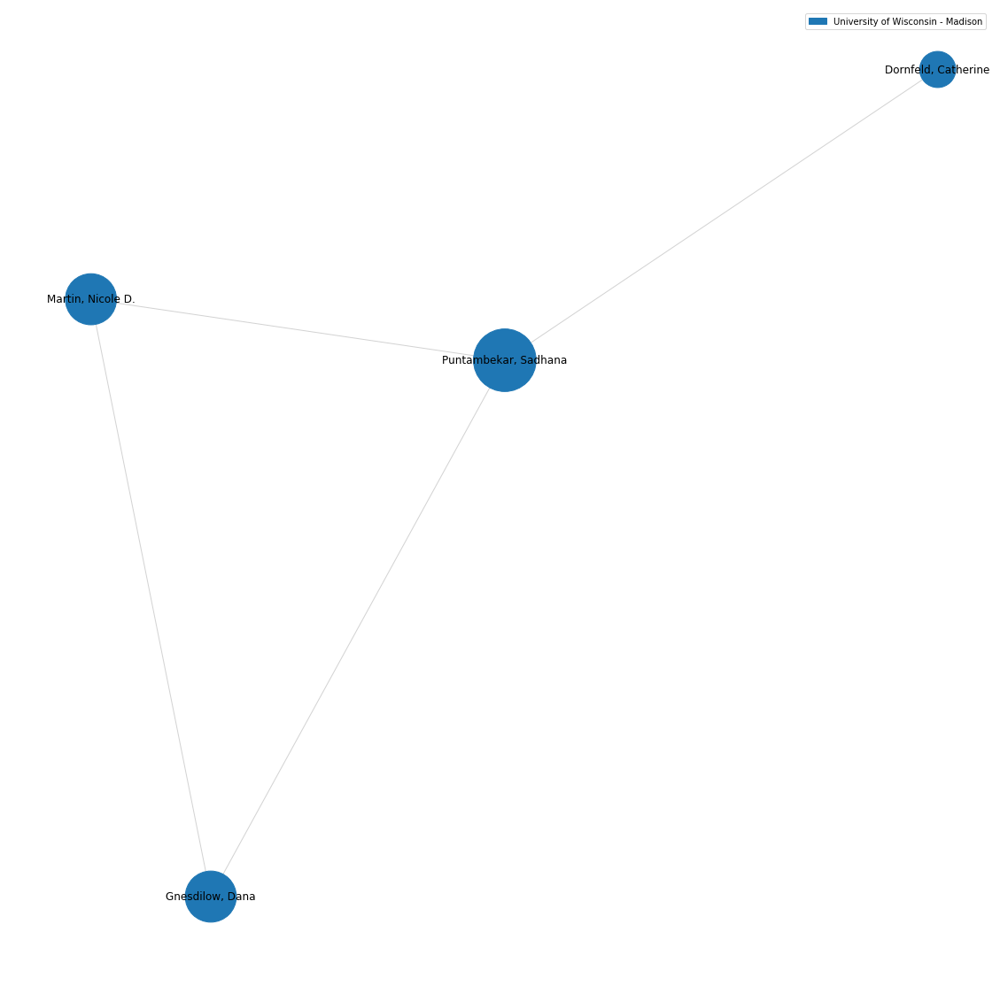

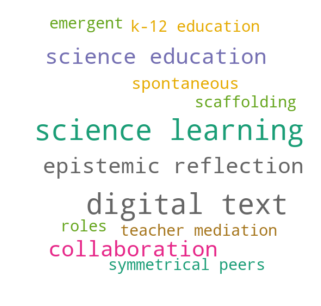

In [58]:
largest_cc_strong = [i for i in list(nx.connected_components(G)) if len(i) > 2]

for i, subgraph in enumerate(largest_cc_strong):
    print('_______\nsubgraph {}\n________'.format(i))
    data = associations[associations.long_name.isin(list(subgraph)) & ~associations.long_name.duplicated()]
    G_ = G.subgraph(subgraph)
    
    helper = list(data.name.unique())
    node_size = np.array(list(nx.degree_centrality(G_).values()))
    node_color = [palette[helper.index(i)] for i in nx.get_node_attributes(G_, 'uni').values()]
    
    plt.figure(figsize=(15, 15))
    
    nx.draw_spring(G_, node_size=node_size*5000, with_labels=True, edge_color='lightgray', 
                   node_color = node_color, cmap=plt.cm.Set1)

    legend = []
    for ind, name in enumerate(helper):
        legend.append(mpatches.Patch(color=palette[ind], label=name))
    plt.legend(handles=legend)
    plt.savefig('figures/yearly_subgraph{}'.format(i))
    plt.show()
    
    keywords = pd.Series(list(nx.get_edge_attributes(G.subgraph(subgraph), 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()
    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=20, 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())

    plt.figure(figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud{}.png'.format(i), bbox_inches='tight')
    plt.show()

## collaboration over one years

In [59]:
G = nx.Graph(((source, target, attr) for source, target, attr in graph.edges(data=True) 
              if attr['year'] == 2018 and attr['weight'] > 3))

nx.set_node_attributes(G, nodes.country.to_dict(), name='country')
nx.set_node_attributes(G, nodes.name.to_dict(), name='uni')
nx.set_edge_attributes(G, keyword_dict, name='keywords')
G = nx.relabel_nodes(G,mapping)

largest_cc_strong = max(nx.connected_components(G), key=len)
len(largest_cc_strong)

3

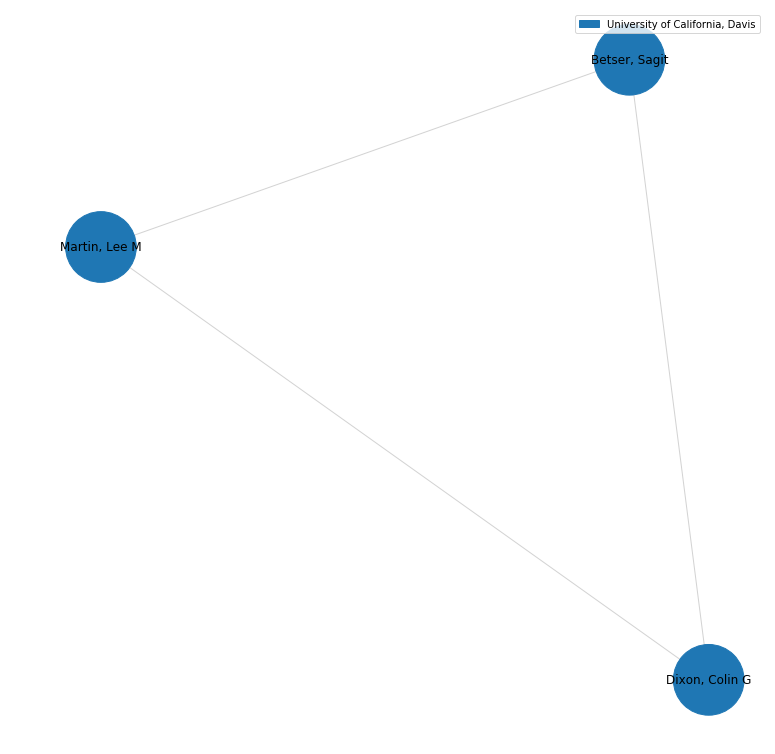

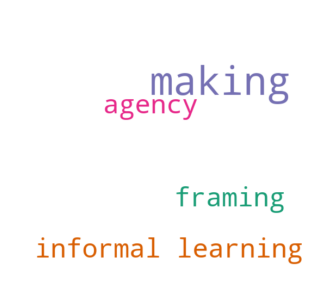

In [60]:
largest_cc_strong = [i for i in list(nx.connected_components(G)) if len(i) > 2]

for subgraph in largest_cc_strong:
    data = associations[associations.long_name.isin(list(subgraph)) & ~associations.long_name.duplicated()]
    G_ = G.subgraph(subgraph)
    
    helper = list(set(nx.get_node_attributes(
        G.subgraph(subgraph), 'uni').values()))
    node_size = np.array(list(nx.degree_centrality(G_).values()))
    node_color = [palette[helper.index(i)] for i in nx.get_node_attributes(G_, 'uni').values()]
    
    plt.figure(figsize=(10, 10))
    
    nx.draw_spring(G_, node_size=node_size*5000, with_labels=True, edge_color='lightgray', 
                   node_color = node_color, cmap=plt.cm.Set1)

    legend = []
    for ind, name in enumerate(helper):
        legend.append(mpatches.Patch(color=palette[ind], label=name))
    plt.legend(handles=legend)
    plt.show()
    
    keywords = pd.Series(list(nx.get_edge_attributes(G.subgraph(subgraph), 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()
    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=20, 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud.png', bbox_inches='tight')
    plt.show()

### Who colaborates the most:

We can easely find the people who worked with the most other people:
(counting repeat collaboration)

In [61]:
nodes['collabs_weighted'] = adjacency.sum(axis=1)
nodes.sort_values(by='collabs_weighted', ascending=False)[['long_name', 'country', 'name', 'collabs_weighted']].head(10)

,long_name,country,name,collabs_weighted
273,"kafai, yasmin",United States,University of Pennsylvania,71
3,"Danish, Joshua A.",United States,Indiana University at Bloomington,65
4,"Enyedy, Noel",United States,"University of California, Los Angeles",53
264,"Horn, Mike",United States,Northwestern University,49
276,"Lui, Debora",United States,DePaul University,48
2,"Tu, Xintian",United States,Indiana University,42
1,"Davis, Bria",United States,Indiana University,42
1081,"Humburg, Megan",United States,Indiana University at Bloomington,40
210,"Sheldon, Joshua",United States,Massachusetts Institute of Technology,39
54,"Georgen, Chris",United States,Carnegie Mellon University,39


Same as above but counting person only once:

In [62]:
nodes['collabs_unweighted'] = np.where(adjacency > 0, 1, 0).sum(axis=1)
nodes.sort_values(by='collabs_unweighted', ascending=False)[['long_name', 'country', 'name', 'collabs_unweighted']].head(10)

,long_name,country,name,collabs_unweighted
264,"Horn, Mike",United States,Northwestern University,45
273,"kafai, yasmin",United States,University of Pennsylvania,44
3,"Danish, Joshua A.",United States,Indiana University at Bloomington,40
276,"Lui, Debora",United States,DePaul University,39
353,"Penuel, Bill",United States,University of Colorado at Boulder,36
4,"Enyedy, Noel",United States,"University of California, Los Angeles",35
2,"Tu, Xintian",United States,Indiana University,33
1081,"Humburg, Megan",United States,Indiana University at Bloomington,33
1,"Davis, Bria",United States,Indiana University,33
54,"Georgen, Chris",United States,Carnegie Mellon University,33


### Zooming into largest community: - country & institution

In [63]:
main_component = nodes[nodes.index.isin(largest_cc)]

Comparing the country representation in main component to the one overall.

Text(0,0.5,'Counts')

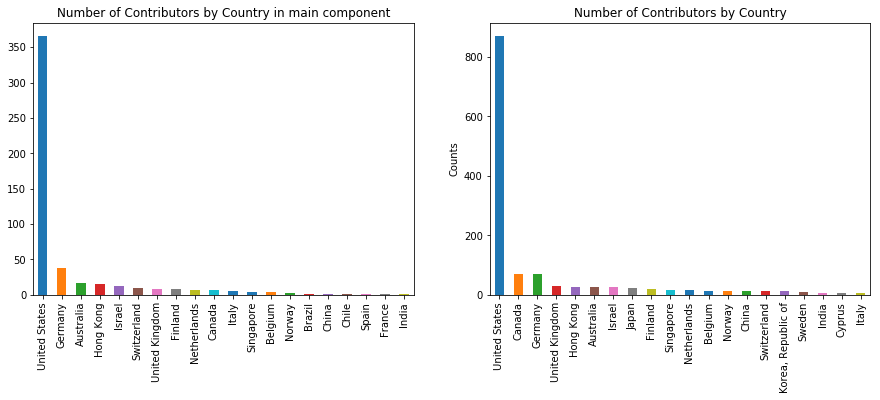

In [64]:
plt.figure(figsize=(15, 5))
plt.subplot(121)
plt.title('Number of Contributors by Country in main component')
main_component.country.value_counts().head(20).plot(kind='bar')
plt.subplot(122)
universities[(~universities.mail.duplicated())].country.value_counts().head(20).plot(kind = 'bar')
plt.title('Number of Contributors by Country') # as determinded by university affiliation
plt.ylabel('Counts')

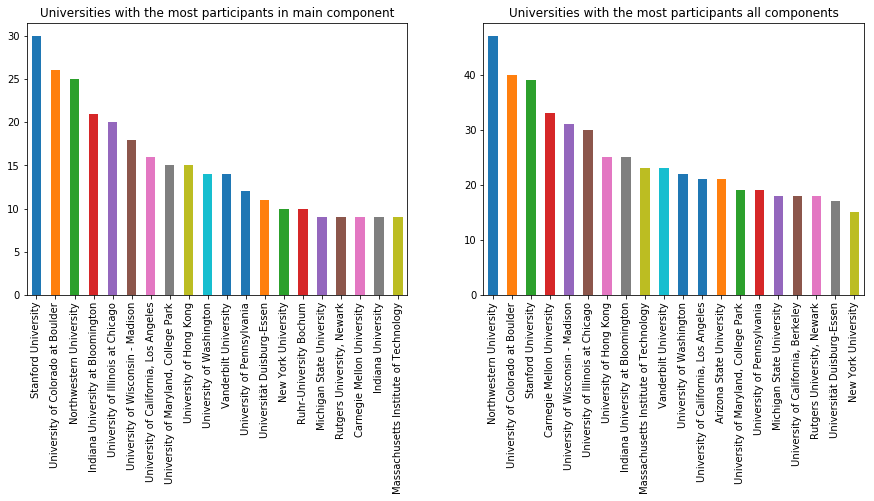

In [65]:
plt.figure(figsize=(15, 5))
plt.subplot(121)
#plt.ylim([0, 60])
plt.title('Universities with the most participants in main component')
main_component.name.value_counts().head(20).plot(kind='bar')
plt.subplot(122)
#plt.ylim([0, 60])
plt.title('Universities with the most participants all components')
universities[(universities.name != 'gmail') & (~universities.mail.duplicated())].name.value_counts().head(20).plot(kind='bar')
plt.show()

## Finding communities in the community: Modularity and Other measures

Constructing the graph with the largest component:

In [66]:
main_component = graph.subgraph(largest_cc)
mapping = nodes.long_name.to_dict()
main_component=nx.relabel_nodes(main_component,mapping)

Here we use modularity to detect communities, which will find subgraph that are unliquely to have developed "randomly".

From wikipedia:

>It was designed to measure the strength of division of a network into modules (also called groups, clusters or communities). Networks with high modularity have dense connections between the nodes within modules but sparse connections between nodes in different modules. Modularity is often used in optimization methods for detecting community structure in networks

In [67]:
c = list(greedy_modularity_communities(main_component))

We find 18 communities in total:

In [68]:
len(c)

16

In [69]:
#smallest community:
min(c, key=len)

frozenset({'Dagan, Efrat',
           'Dubovi, Ilana',
           'Lee, Victor',
           'Levin, Nehama - Levin',
           'Levy, Milana'})

## clique detection:


Here we look at large groups of researchers that all have collaborated within eachother.
Only look at connections with weight at least 3 -> at least 3 collaborations, froming a clique of at least 7 people.

In [70]:
mc = nx.from_numpy_array(np.where(nx.to_numpy_array(main_component) >= 2, 1, 0))

main_component_ =nx.relabel_nodes(mc, mapping)
large_cliques = [l for l in list(nx.find_cliques(main_component_)) if len(l) > 6]

large_cliques[0]

['Shapiro, R. Benjamin',
 'De Backer, Liesje',
 'Silver, Cindy Hmelo',
 'Gupta, Ayush',
 'Palmgren, Elina',
 'Gouvea, Julia Svoboda',
 'Weinberger, Armin',
 'Walkington, Candace A']

We get a total of 12 groups:

In [71]:
len(large_cliques)

2

In [72]:
main_component_clique = nx.from_numpy_array(nx.to_numpy_array(main_component))

In [73]:
mc = nx.from_numpy_array(np.where(nx.to_numpy_array(main_component_clique) >=2, 1, 0))

In [74]:
large_cliques = [l for l in list(nx.find_cliques(mc)) if len(l) > 6]
color_cliques = {}
set_inclique = set()
for i, clique in enumerate(large_cliques):
    for member in clique:
        color_cliques[member] = i+1
        set_inclique.add(member)

In [75]:
for member in (set(main_component_clique.nodes)-set_inclique):
    color_cliques[member] = 0

Define colormap for better plotting:

   0  ||  1


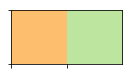

In [76]:
palette = sns.color_palette(palette='Spectral', n_colors=len(large_cliques))

sns.palplot(palette)
print('  ', '  ||  '.join([str(i) for i in list(range(len(large_cliques)))]))

In [77]:
colors = ['#C7C7C7'] + \
    sns.color_palette(palette='Spectral', n_colors=30).as_hex()

In [78]:
node_size = (np.array(list(nx.degree_centrality(main_component_clique).values())))
edge_color= np.array(list(nx.get_edge_attributes(main_component_clique, 'weight').values()))

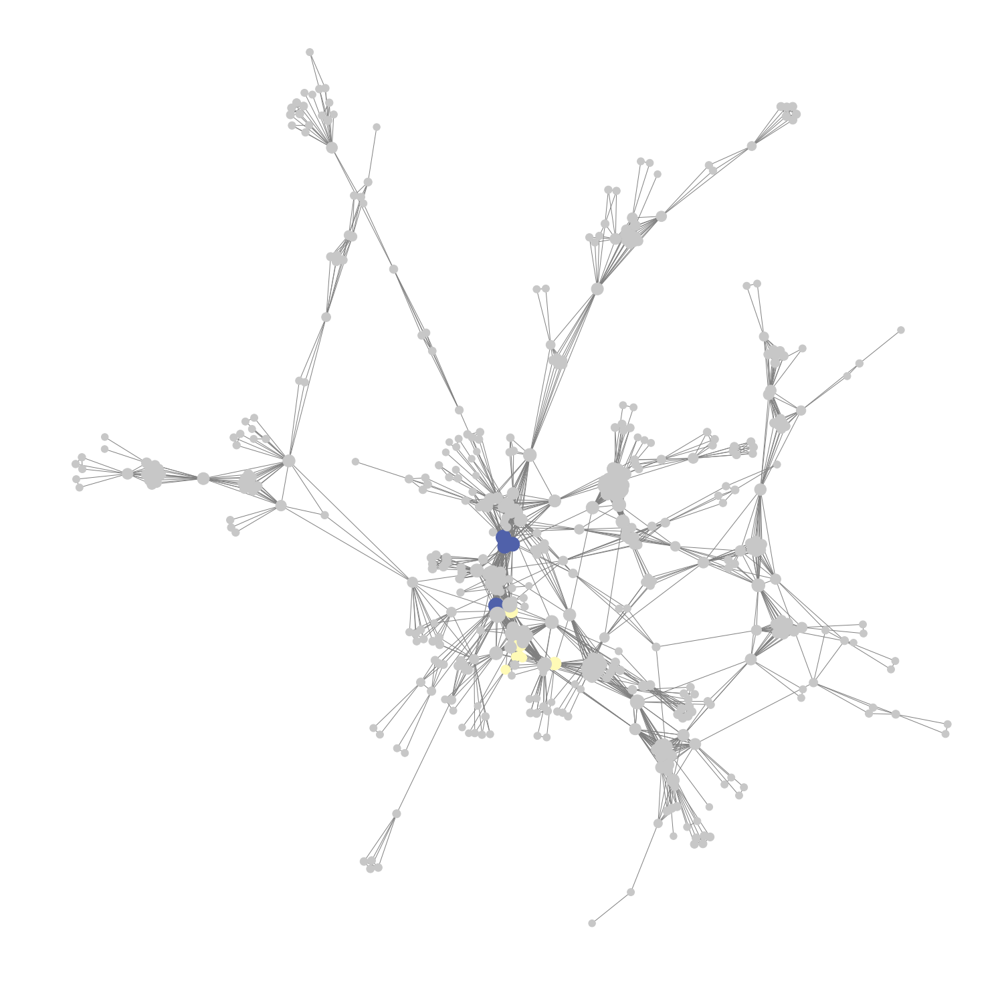

In [79]:
plt.figure(figsize=(20, 20))
nx.draw_spring(main_component_clique, node_color=pd.Series(color_cliques).sort_index().tolist(), 
              cmap=ListedColormap(colors),
              node_size=(node_size+node_size.mean())*5000,
               edge_color='grey',
               iterations=400, seed = 4)

# Using spectral clustering to identify communities:

In [80]:
mapping = nodes.long_name.to_dict()

We change the node size based on degree centrality, the larger the node the more collaborations the individual has:

In [81]:
node_size = np.array(list(nx.betweenness_centrality(main_component).values()))

   1  ||  2  ||  3  ||  4  ||  5  ||  6  ||  7  ||  8  ||  9  ||  10  ||  11  ||  12  ||  13  ||  14  ||  15  ||  16  ||  17  ||  18  ||  19  ||  20  ||  21  ||  22  ||  23  ||  24  ||  25  ||  26


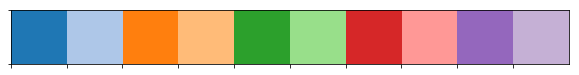

In [82]:
palette = sns.color_palette(palette='tab20', n_colors=10)#len(10)+1)

sns.palplot(palette)
print('  ', '  ||  '.join([str(i) for i in list(range(1, 26+1))]))

In [83]:
n_cluster = 10

In [84]:
from sklearn.cluster import SpectralClustering

# Cluster
sc = SpectralClustering(n_cluster, affinity='precomputed', n_init=100, random_state=80)
sc.fit(nx.adj_matrix(main_component))

# Compare ground-truth and clustering-results
print('spectral clustering')
print(pd.Series(sc.labels_).value_counts())

spectral clustering
0    185
2    105
9     68
4     43
7     31
1     24
8     23
6     14
5     13
3      5
dtype: int64


In [85]:
l = pd.Series(sc.labels_)

l[l.map({5: 0, 0: 2, 2:5, 8:6, 6:8}).notna()] = l.map({5: 0, 0: 2, 2:5, 8:6, 6:8})

In [86]:
l.value_counts()

2    185
5    105
9     68
4     43
7     31
1     24
6     23
8     14
0     13
3      5
dtype: int64

In [87]:
pos = nx.layout.spring_layout(main_component, seed=4)

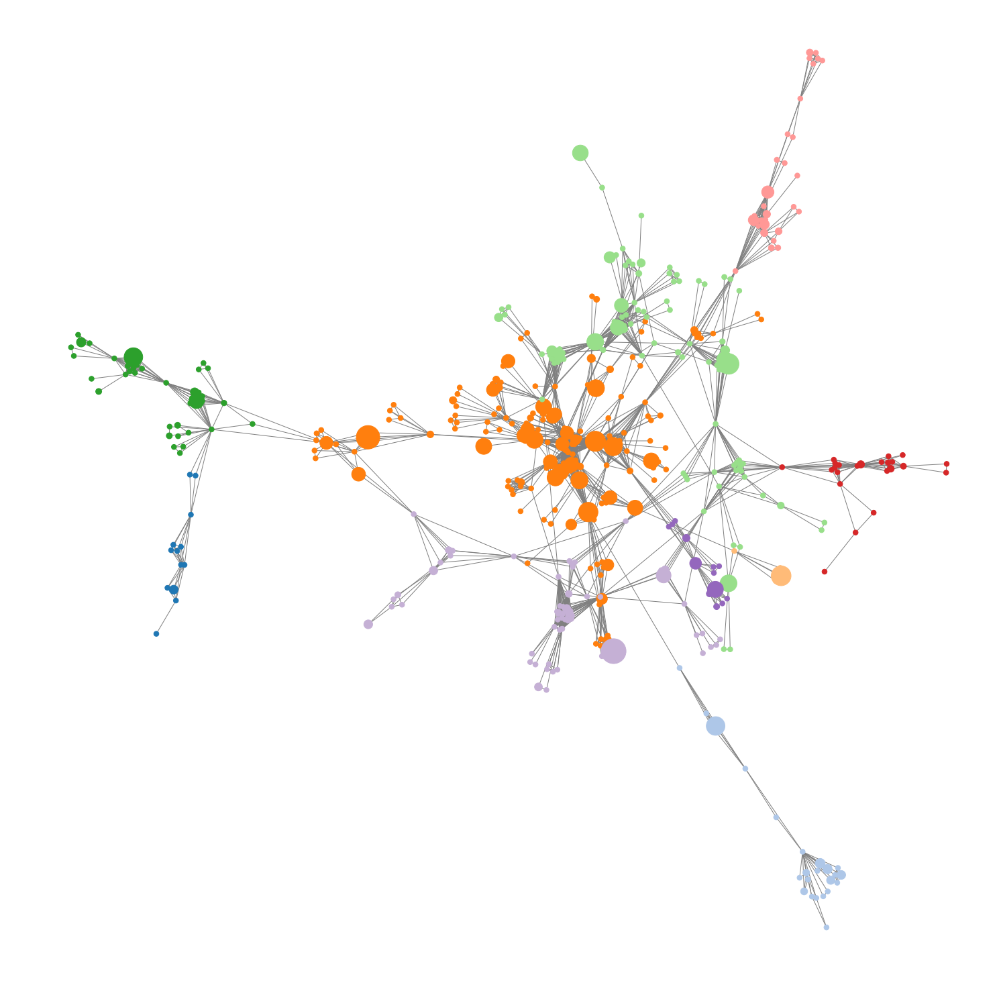

In [88]:
plt.figure(figsize=(20, 20))


nx.draw(main_component,pos=pos, node_color=l.tolist(),#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       node_size=(node_size+node_size.mean())*6000,
                       #labels=labels,
               edge_color='grey',
              )
plt.savefig('figures/three_cluster')

In [89]:
nx.write_gpickle(main_component, "main_component.gpickle")

In [90]:
main_component = nx.read_gpickle('main_component.gpickle')

In [91]:
N = main_component.number_of_nodes()
nodes_ = main_component.nodes
E = main_component.edges.keys()

Xv=[pos[k][0] for k in nodes_]
Yv=[pos[k][1] for k in nodes_]

Xed=[]
Yed=[]
for edge in E:
    Xed+=[pos[edge[0]][0],pos[edge[1]][0], None]
    Yed+=[pos[edge[0]][1],pos[edge[1]][1], None] 
    
trace3=Scatter(x=Xed,
               y=Yed,
               mode='lines',
               line=dict(color='rgb(210,210,210)', width=1),
               hoverinfo='none'
               )
trace4=Scatter(x=Xv,
               y=Yv,
               mode='markers',
               name='net',
               marker=dict(symbol='circle-dot',
                             size=node_size*100, 
                             color=l.tolist(),
                             line=dict(color='rgb(50,50,50)', width=0.5)
                             ),
               text=list(nodes_),
               hoverinfo='text'
               )


data1=[trace3, trace4]


layout=Layout(title= "Core of university graph",
    font= dict(size=12),
    showlegend=False,
    autosize=False,
    width=700,
    height=700,      
    hovermode='closest',
    annotations=[
           dict(
           showarrow=False, 
            xref='paper',     
            yref='paper',     
            x=0,  
            y=-0.1,  
            xanchor='left',   
            yanchor='bottom',  
            font=dict(
            size=14 
            )     
            )
        ]          
    )


fig1=Figure(data=data1, layout=layout)
#fig1['layout']['annotations'][0]['text']=annot

iplot(fig1, validate=False)

In [92]:
centrality = nx.betweenness_centrality(main_component)
np.quantile(np.array(list(centrality.values())), 0.9)

0.030089722903808413

In [93]:
#lables = nodes['long_name'].to_dict()

labels = { key: key for (key, value) in centrality.items() if value > 0.03}

node_size = np.array(list(centrality.values()))*5000

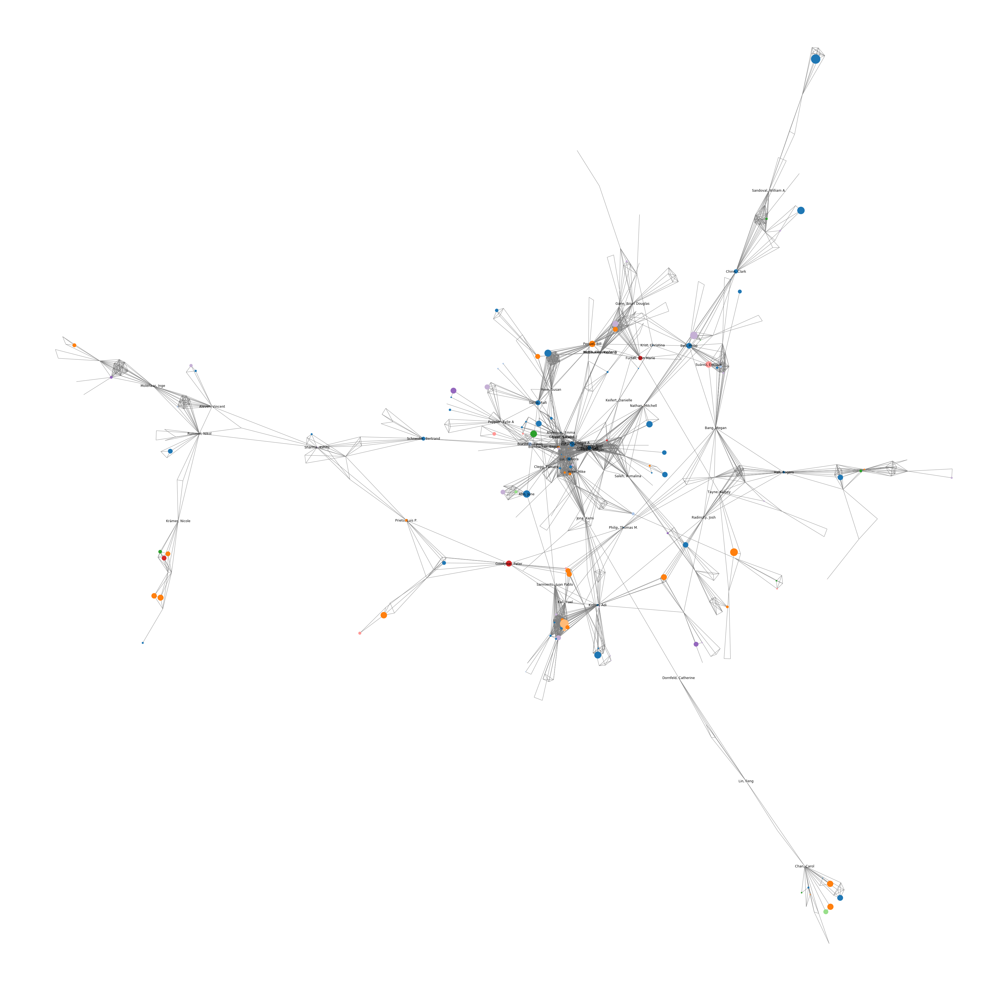

In [94]:
plt.figure(figsize=(50, 50))

nx.draw(main_component,pos=pos, node_color=sc.labels_,#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       node_size=node_size,
                       labels=labels,
               edge_color='grey',
       )

In [95]:
from community import community_louvain
partition = community_louvain.best_partition(main_component)
#partition = nx.algorithms.community.greedy_modularity_communities(main_component)
#partition = nx.algorithms.community.asyn_lpa_communities(main_component)

In [96]:
pd.Series(partition).value_counts().mean()

28.38888888888889

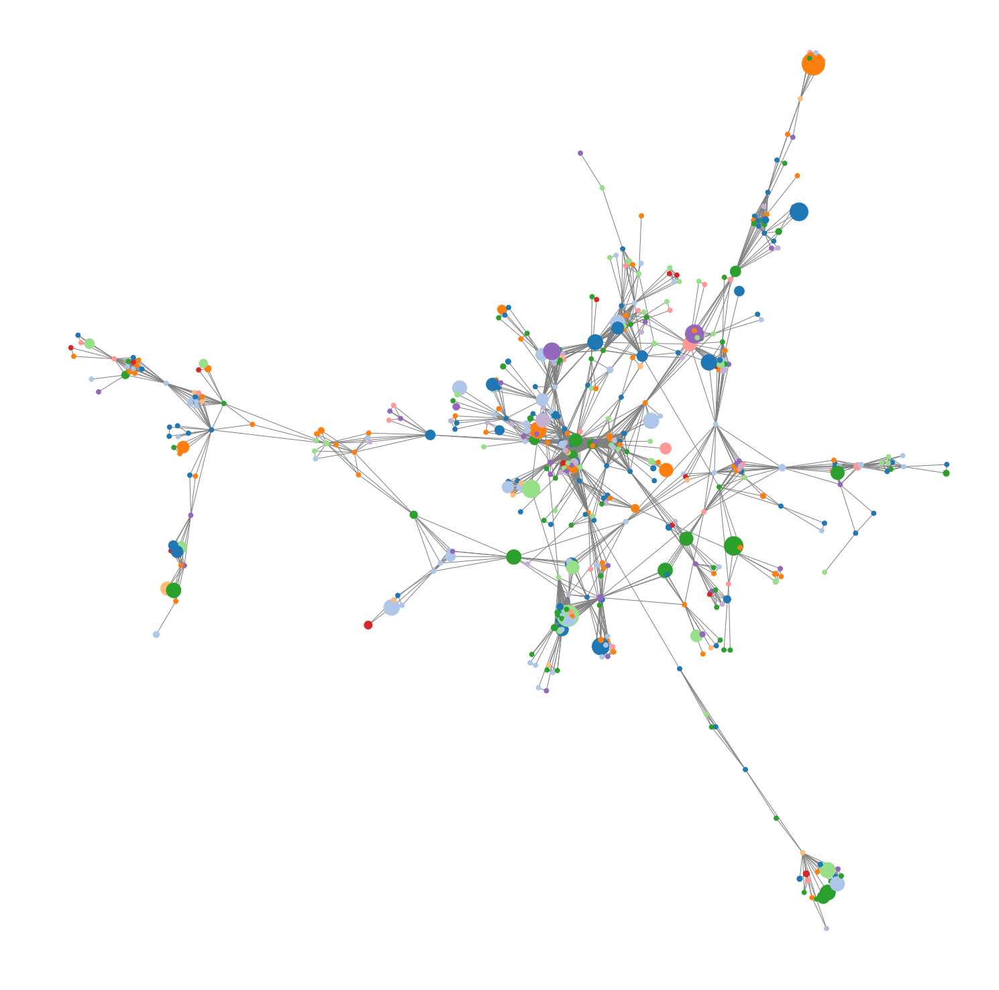

In [97]:
plt.figure(figsize=(20, 20))

nx.draw(main_component, pos=pos, node_color=pd.Series(partition),#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       node_size=(node_size+node_size.mean()),
                       #labels=labels,
               edge_color='grey',
               iterations=10)
plt.savefig('figures/20_cluster')

plotting this geographically, we see that there is no clear geographical clustering belonging to these commuitues!

### Analyzing each subcomponent

We look at distribution of country and inst. inside these clusters (my it's associated members):

Here we have to code that allows to load this graph in Gephi.

In [98]:
df = pd.DataFrame(list(main_component.nodes), columns=['name'])
df['label'] = sc.labels_
df['size'] = node_size
df.head()

,name,label,size
0,"Mangaroska, Katerina",9,0.000000
1,"Shapiro, R. Benjamin",2,0.000000
2,"Bell, Amanda M",9,39.138642
3,"Sfard, Anna",0,0.000000
4,"Kollar, Ingo",8,85.155009


In [99]:
c = df.groupby('label').apply(lambda x: set(x['name'].tolist())).tolist()

In [100]:
c = [(i,x) for i,x in enumerate(c) if len(x) > 50]

In [101]:
len(c)

3

As this graph is quite large, we build a smaller graph by cutting off outer nodes, and looking into the connector nodes:

In [102]:
nx.set_node_attributes(main_component, nodes.set_index('long_name').apply(
    lambda x:[x.Lon, x.Lat], axis=1).to_dict(), 'location')

Cluster dist for cluster 1


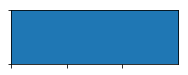

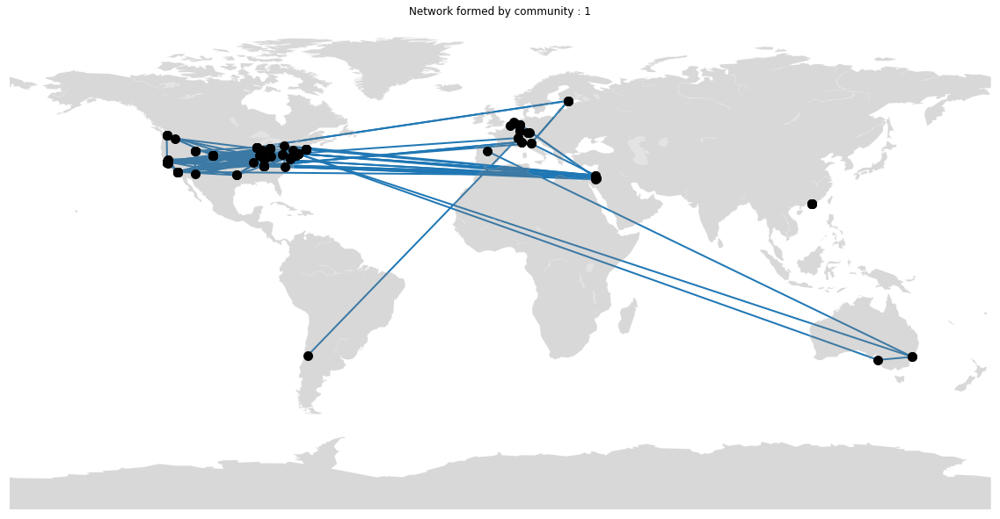

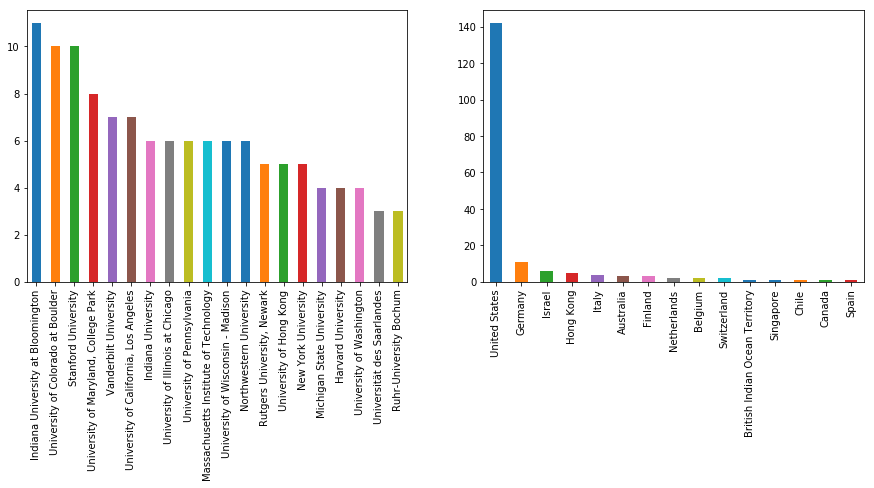

Number of countries in cluster:  15
Number of institutions in cluster:  65
Number of people in cluster:  185


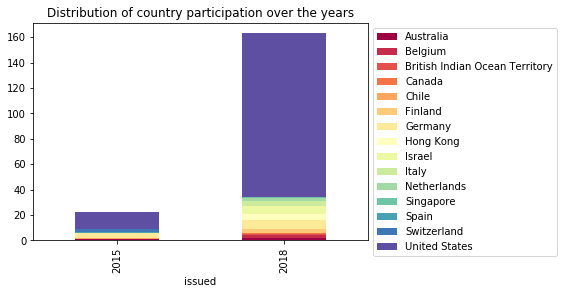

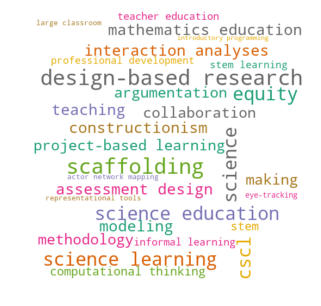

                          centrality
0                                   
Price, Aaron                0.073696
Moore, Allison              0.060584
Vosniadou, Stella           0.048868
Noushad, Noora F Noushad    0.048527
Ocumpaugh, Jaclyn           0.043656
Keifert, Danielle           0.030782
Semerjian, Amy R.           0.029579
Horstman, Theresa           0.029263
Wendel, Daniel              0.028332
Jona, Kemi                  0.025303
Cluster dist for cluster 3


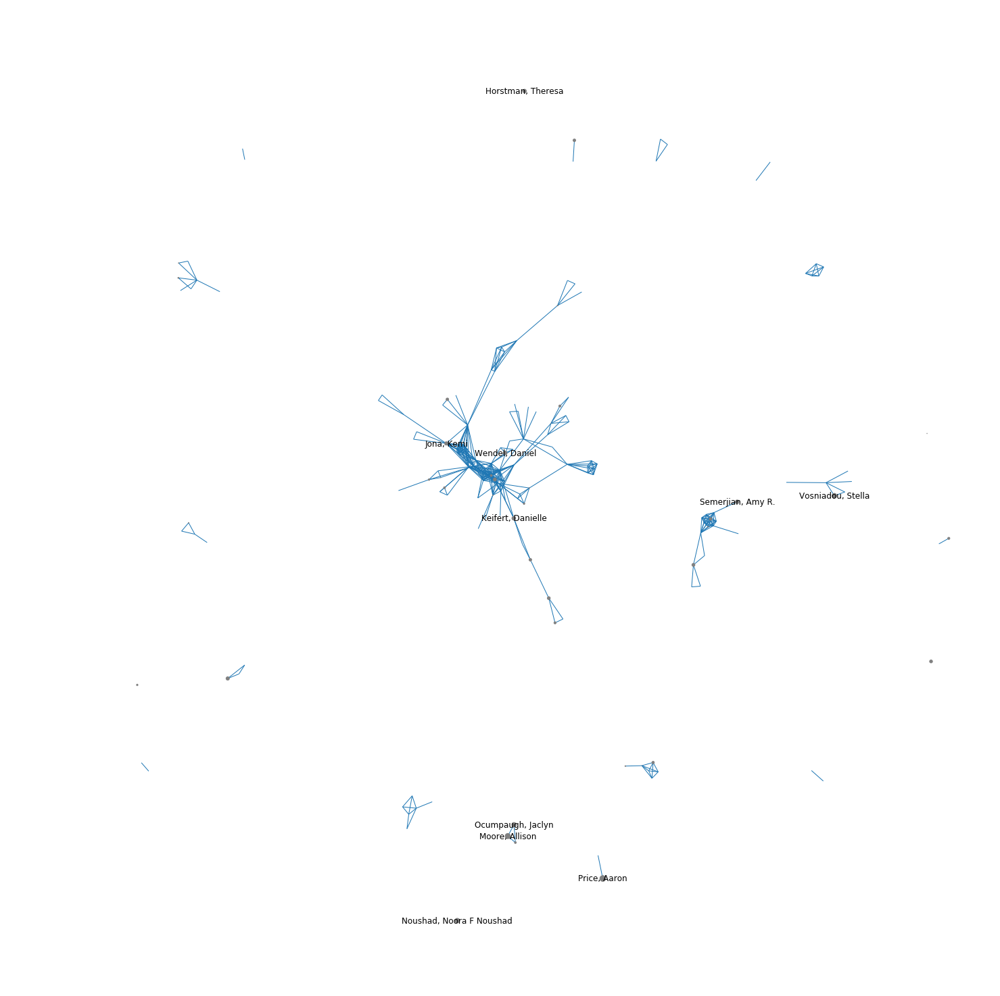

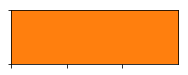

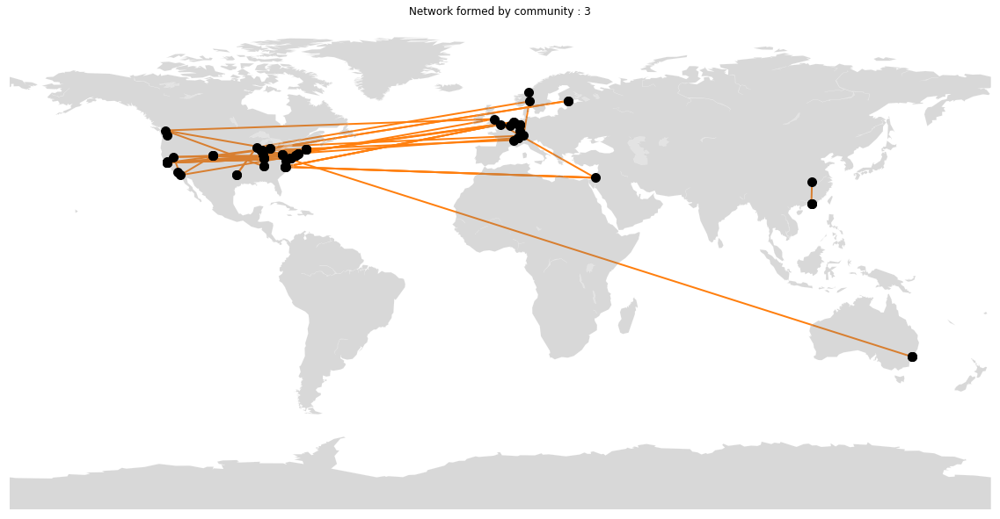

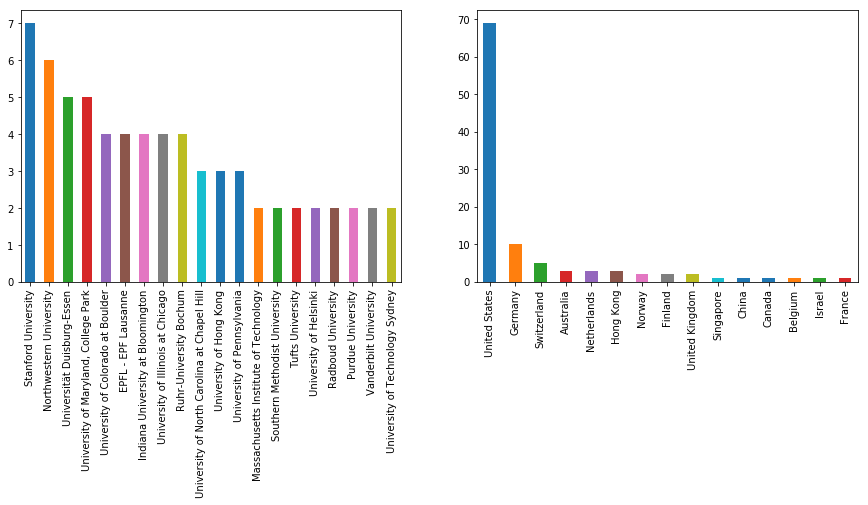

Number of countries in cluster:  15
Number of institutions in cluster:  52
Number of people in cluster:  105


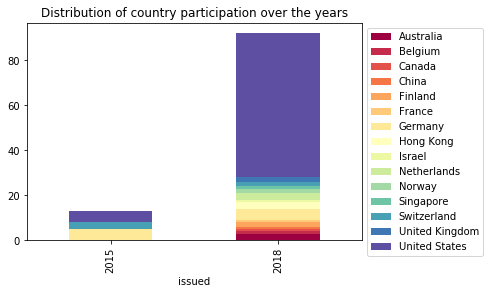

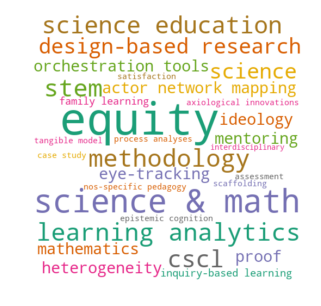

                              centrality
0                                       
Anderson, Theresa Dirndorfer    0.008962
Yung, Benny                     0.008215
Teo, Chew Lee                   0.004481
Kyewski, Elias                  0.004481
Werneburg, Sören               0.004294
Georgen, Chris                  0.002987
Kopp, Daniel                    0.002427
Biswas, Gautam                  0.001680
Nathan, Mitchell                0.001120
Garcia, Antero                  0.001120
Cluster dist for cluster 10


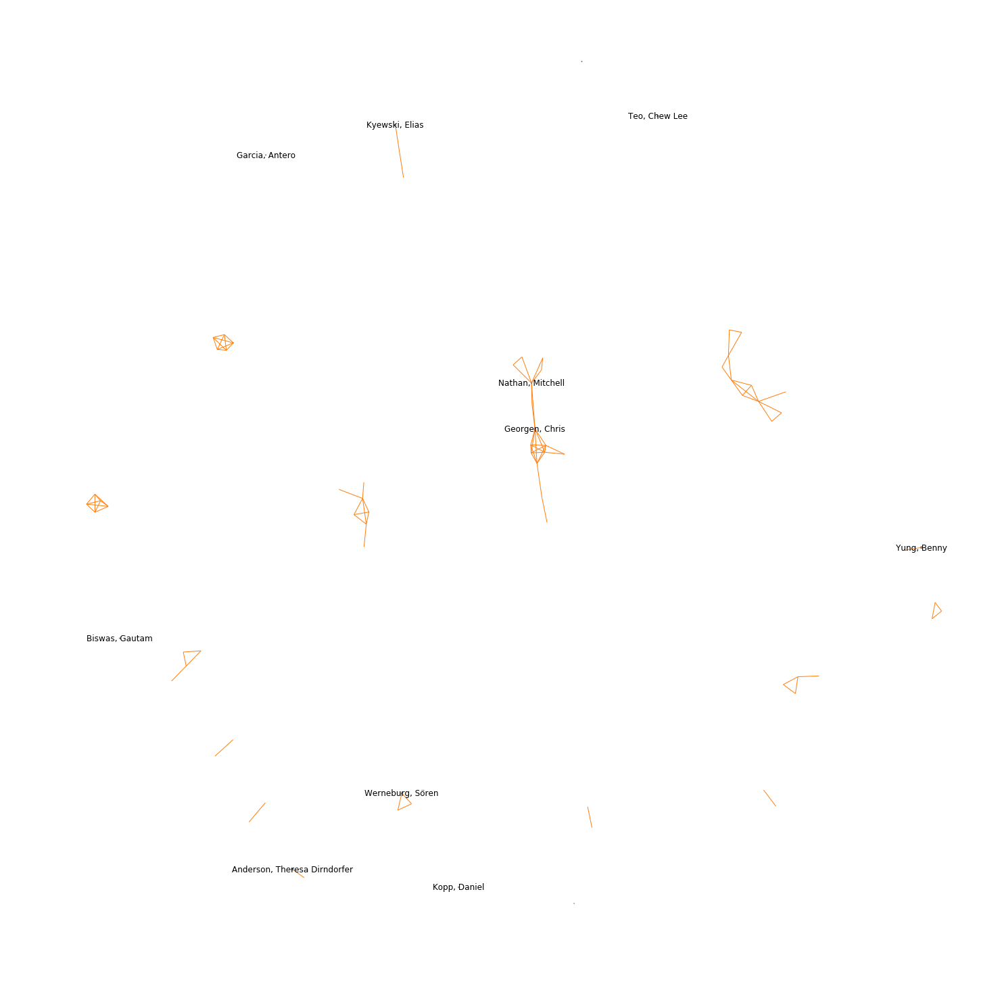

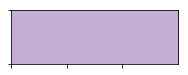

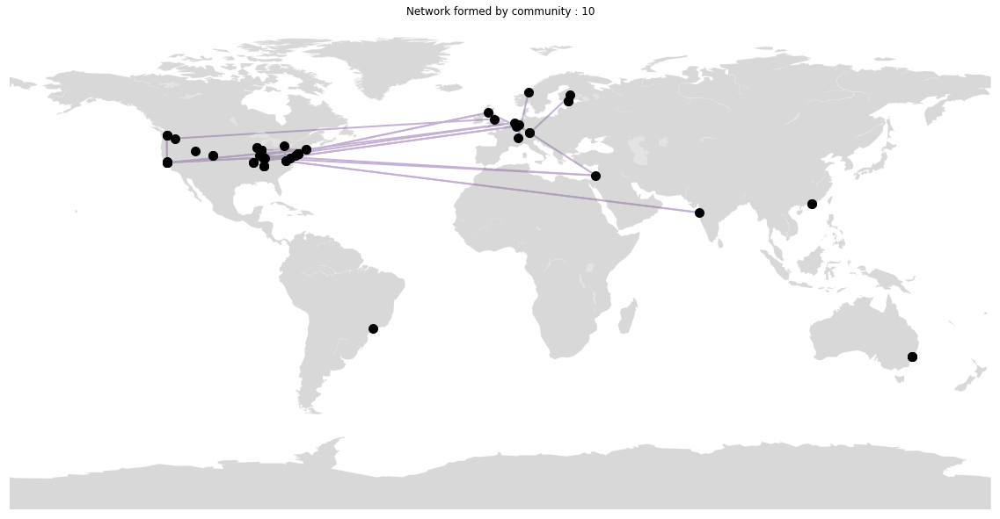

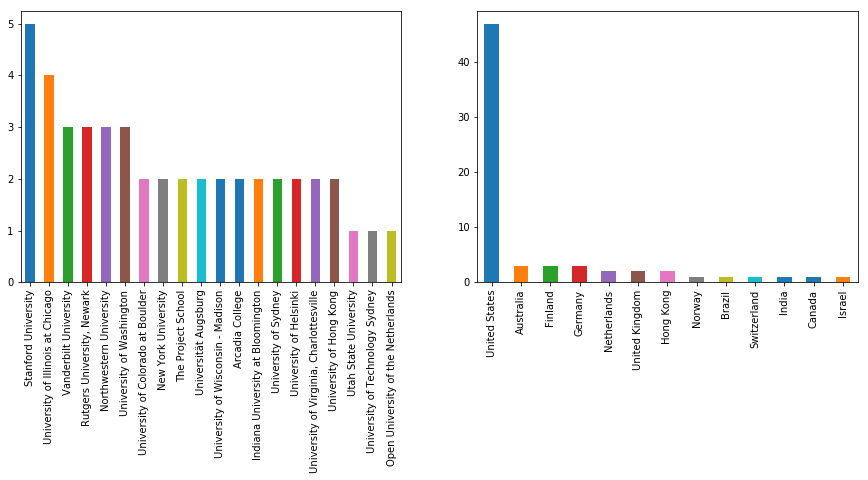

Number of countries in cluster:  13
Number of institutions in cluster:  42
Number of people in cluster:  68


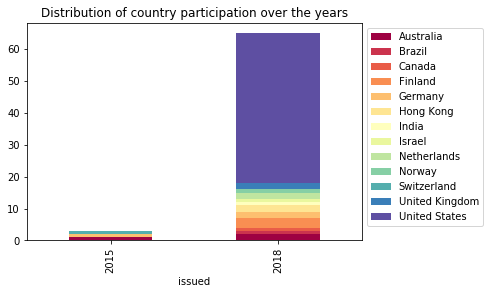

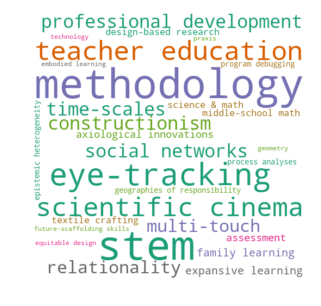

                      centrality
0                               
Chiu, Jennifer          0.000905
Mangaroska, Katerina    0.000678
Swanson, Hillary        0.000678
Rosebery, Ann S         0.000000
Castro-Faix, Moraima    0.000000
Brown, David            0.000000
Laherto, Antti          0.000000
Bywater, Jim P          0.000000
Hagani, Shiri Mor       0.000000
Tolar, Erin             0.000000


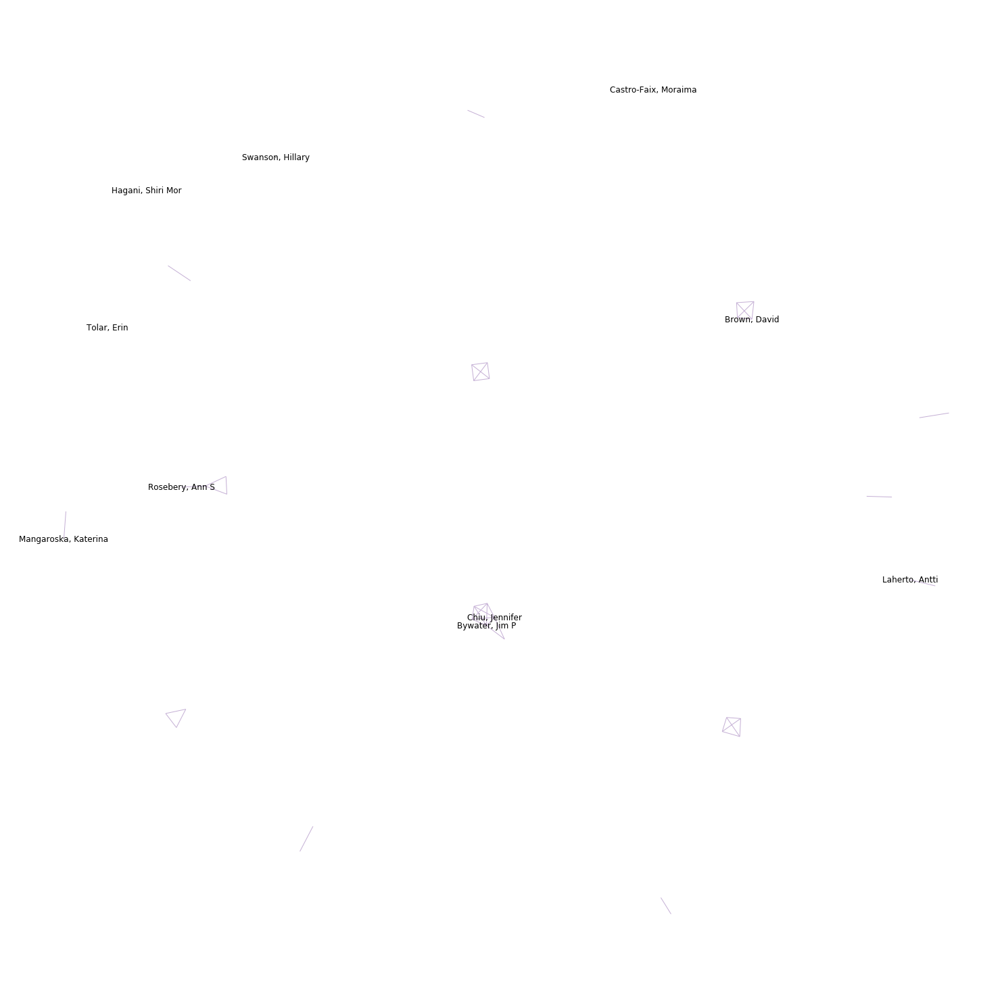

In [103]:
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt

for i, cluster in c:
    print('Cluster dist for cluster {}'.format(i+1))
    sns.palplot(palette[i])
    
    plt.figure(figsize=(20, 20))
    #draw_map_plot(data, palette.as_hex()[i])

    comp = main_component.subgraph(cluster)
    embedding = nx.get_node_attributes(comp, 'location')
        
    m=Basemap()
    m.drawmapboundary(linewidth=0)
    m.fillcontinents(color='grey', alpha=0.3)
    m.drawcoastlines(linewidth=0.1, color="white")
    node_size = 1 #np.array(list(nx.betweenness_centrality(main_component.subgraph(cluster)).values()))
    nx.draw(comp,  
            pos = nx.get_node_attributes(comp, 'location'), 
            node_size= node_size*100,
            edge_color=palette.as_hex()[i],
            node_color='black',
            width = 2)
    
    plt.title('Network formed by community : {}'.format(i+1))
    plt.show()
    
    #adding inner cluster distribution plot
    plt.figure(figsize=(15,5))
    plt.subplot(121)
    nodes[nodes.long_name.isin(cluster)].name.value_counts().head(20).plot('bar')
    plt.subplot(122)
    nodes[nodes.long_name.isin(cluster)].country.value_counts().head(20).plot('bar')
    plt.show()
    
    #getting some concrete values
    print('Number of countries in cluster: ', len(nodes[nodes.long_name.isin(cluster)].country.unique()))
    print('Number of institutions in cluster: ', len(nodes[nodes.long_name.isin(cluster)].name.unique()))
    print('Number of people in cluster: ', len(nodes[nodes.long_name.isin(cluster)].long_name.unique()))
    
    #plt.title('Number of people submitting over the years over the years')
    
   
    plot_df = pd.DataFrame(nodes[nodes.long_name.isin(cluster)].groupby(['issued'])\
                           .country.value_counts()).rename(columns={'country':'count'}).reset_index()
    plot_df.pivot(index='issued', columns='country', values='count').plot(kind='bar', stacked=True, colormap=plt.cm.Spectral)
    plt.title('Distribution of country participation over the years')
    plt.legend(bbox_to_anchor=(1, 1))
    
    plt.show()    
    
    keywords = pd.Series(list(nx.get_edge_attributes(comp, 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()
    
    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=30, 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())
    
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('figures/wordcloud_commuity{}.png'.format(i), bbox_inches='tight')
    plt.show()
    
    
    node_size = np.array(list(nx.betweenness_centrality(comp).values()))
    persons_of_interest = pd.DataFrame(list(comp.nodes)).copy()
    persons_of_interest['centrality'] = node_size

    persons_of_interest.centrality.quantile(.97)

    labels = persons_of_interest.sort_values(by='centrality', ascending=False).head(10)
    print(labels.set_index(0))
    
    layout = nx.drawing.layout.spring_layout(comp, scale=3)
    labels['n']  = labels[0]
    labels = labels.set_index(0).n.to_dict()
    plt.figure(figsize=(20, 20))
    nx.draw(comp, pos=layout,
            node_size=node_size*1000,
            edge_color=palette.as_hex()[i],
            node_color='grey',
            width = 1, labels=labels)

## Looking at people moving around

We now look at people who moved from one country to an other within the period of the papers in the parsed papers:

We have to look at years as well to avoid duplicates, however, this could be due to people being associated to multiple institutions at once.

In [105]:
name_country = associations[['name', 'mail', 'country', 'long_name', 'shortend_names','issued']]

In [106]:
#Add year to see
df = pd.merge(name_country, name_country, on='long_name').dropna()
df = df[df.shortend_names_x == df.shortend_names_y]
df = df[df.country_x != df.country_y]
df = df[df.issued_x <= df.issued_y]
df = df[~df[['long_name','name_x', 'name_y']].duplicated()]
df

,name_x,mail_x,country_x,long_name,shortend_names_x,issued_x,name_y,mail_y,country_y,shortend_names_y,issued_y
813,University of Hong Kong,yqyang@hku.hk,Hong Kong,"Yang, Yuqin",Yang Y.,2015,Central China Normal University,yuqinyang0904@gmail.com,China,Yang Y.,2018
1040,EPFL - EPF Lausanne,kshitij.sharma@epfl.ch,Switzerland,"Sharma, Kshitij",Sharma K.,2015,Norwegian University of Science and Technology,kshitij.sharma@ntnu.no,Norway,Sharma K.,2018
1976,Hanyang University,shinyoonhee06@gmail.com,"Korea, Republic of","Doroudi, Shayan",Doroudi S.,2018,Carnegie Mellon University,shayand@cs.cmu.edu,United States,Doroudi S.,2018
1977,Carnegie Mellon University,shayand@cs.cmu.edu,United States,"Doroudi, Shayan",Doroudi S.,2018,Hanyang University,shinyoonhee06@gmail.com,"Korea, Republic of",Doroudi S.,2018
2156,Ludwig-Maximilians-Universität München,Esther.Tan@psy.lmu.de,Germany,"Tan, Esther",Tan E.,2015,Open University of the Netherlands,esther.tan@ou.nl,Netherlands,Tan E.,2018
2566,University of Hong Kong,irisfeng83@gmail.com,Hong Kong,"Lin, Feng",Lin F.,2015,University of Wisconsin - Madison,feng.lin@wisc.edu,United States,Lin F.,2018


we can see that within 4 years, a total of 20 repeat participants moved to universities in different countries!

In [107]:
df.long_name.drop_duplicates().shape

(5,)

In [108]:
new_homes = set(df.name_x).union(set(df.name_y))
len(new_homes)

9

In [109]:
len(set(df.name_y))

6

In [110]:
movement_graph = nx.from_pandas_edgelist(df, source='name_x', 
                                         target='name_y', edge_attr=['long_name', 'issued_y'],
                                        create_using=nx.DiGraph)
names = list(movement_graph.nodes)

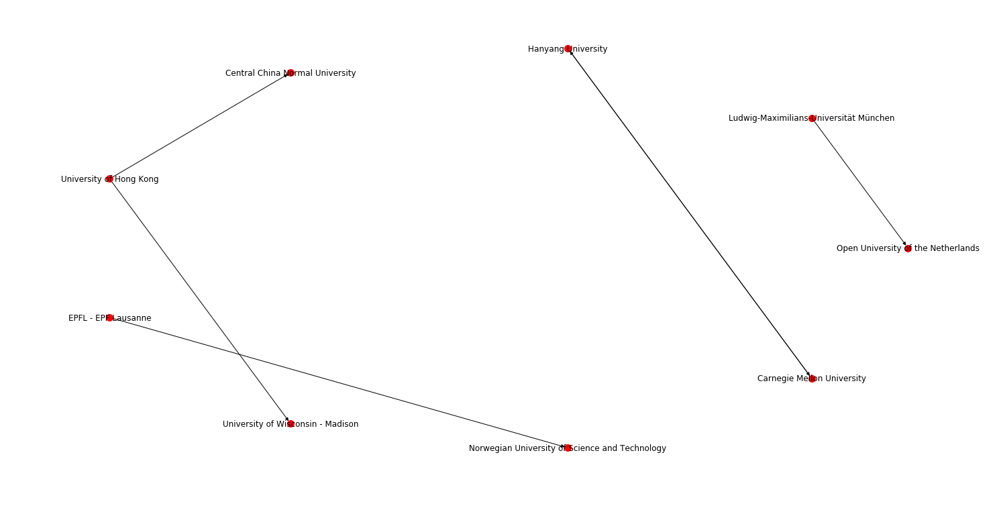

In [111]:
plt.figure(figsize=(20, 10))
nx.draw_circular(movement_graph, node_size=100,
                 labels=pd.DataFrame(names, names).to_dict()[0], 
                )

a total of 70 people change university overall all

In [112]:
#Add year to see
name_country = associations[associations.Lat.notna()][['name', 'mail', 'country', 'long_name', 'shortend_names','issued']]
df = pd.merge(name_country, name_country, on='long_name').dropna()
df = df[df.shortend_names_x == df.shortend_names_y]
df = df[df.name_x != df.name_y]
df = df[df.issued_x <= df.issued_y]
df = df[~df[['long_name','name_x', 'name_y']].duplicated()]
df.long_name.drop_duplicates().shape

(17,)

In [113]:
new_homes = set(df.name_x).union(df.name_y)
len(new_homes)

24

In [114]:
movement_graph = nx.from_pandas_edgelist(df, 
                                         source='name_x', 
                                         target='name_y', 
                                         edge_attr=['long_name', 'issued_y'], 
                                         create_using=nx.DiGraph)


In [115]:
name_loc_mapping = pd.DataFrame(associations[associations.name.isin(new_homes) & ~associations.name.duplicated()].name.copy())

In [116]:
name_loc_mapping['loc'] = associations[associations.name.isin(new_homes) & ~associations.name.duplicated()
                                      ].apply(lambda x: np.array([x.Lon, x.Lat]) , axis=1)

In [117]:
name_loc_mapping = name_loc_mapping.set_index('name')['loc'].to_dict()

In [118]:
nx.set_node_attributes(movement_graph,name_loc_mapping, 'pos')

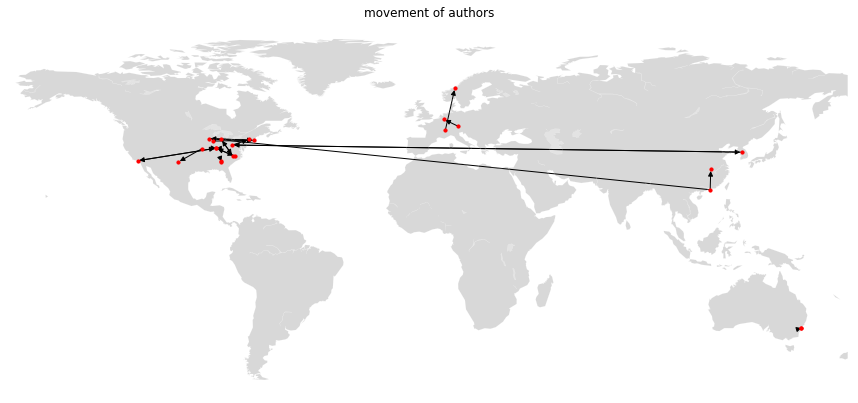

In [119]:
#
names = list(movement_graph.nodes)

plt.figure(figsize=(15, 10))
plt.title('movement of authors')
m=Basemap(llcrnrlon=-170,urcrnrlon=170,llcrnrlat=-60,urcrnrlat=90)
m.drawmapboundary(linewidth=0)
m.fillcontinents(color='grey', alpha=0.3)
m.drawcoastlines(linewidth=0.1, color="white")
nx.draw(movement_graph, node_size=10,
        #labels=pd.DataFrame(names, names).to_dict()[0], 
        pos=nx.get_node_attributes(movement_graph, 'pos'),
        k = 1000)
plt.savefig('figures/movement_map')

## Looking at the network over the years

One interessting observation is that the ICLS years are much more dense and connected.

In [120]:
associations.issued.unique()

array([2018, 2015])

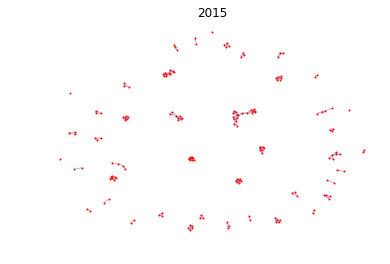

Density of the graph :  0.02157548057534615
The largest component has  19 nodes accounting for 10.98 % of the nodes
The diameter of the largest component is 4
The clustering coeff of is 0.7905128910909258


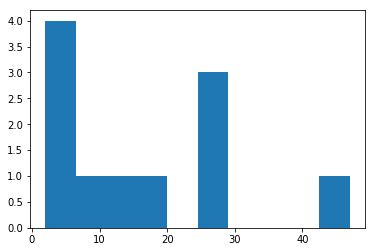

The average shortest path length in the main component is :  2.134502923976608
Attribute Assortativity coef: Country:  0.7521957022450582
Attribute Assortativity coef: Uni:  0.610344286920941
1      4
2     11
3     12
4      4
5      2
6      3
7      3
8      1
9      1
10     1
19     1
dtype: int64


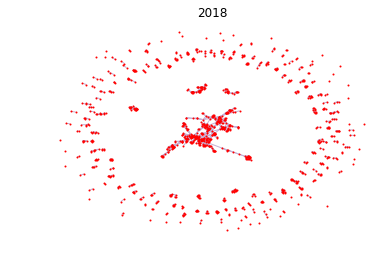

Density of the graph :  0.0054722715610815076
The largest component has  412 nodes accounting for 36.59 % of the nodes
The diameter of the largest component is 14
The clustering coeff of is 0.7657434909232406


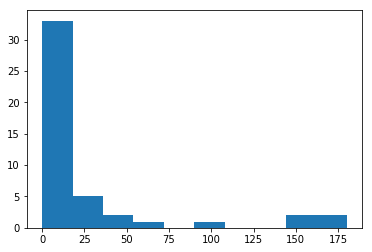

The average shortest path length in the main component is :  5.292348758651643
Attribute Assortativity coef: Country:  0.5000369449234375
Attribute Assortativity coef: Uni:  0.33141476122034563
1      41
2      53
3      35
4      21
5      22
6      10
7       8
8       1
9       3
10      2
11      1
19      1
24      1
43      1
412     1
dtype: int64


In [121]:
for year in sorted(associations.issued.unique()):

    
    #getting the data in shape to build the graph
    year_assoc = associations[(associations.country.notna()) & (associations.issued==year)]

    self_merge = pd.merge(year_assoc, year_assoc, on='file')
    self_merge = self_merge[self_merge.long_name_x != self_merge.long_name_y]


    nodes = year_assoc[~year_assoc.long_name.duplicated()].reset_index(drop=True).reset_index()
    name_index = nodes.long_name.to_dict()
    name_index = {v: k for k, v in name_index.items()}

    self_merge['source'] = self_merge.long_name_x.map(name_index)
    self_merge['target'] = self_merge.long_name_y.map(name_index)

    #building the graph
    adjacency = get_adjacency(nodes, self_merge)
    graph = nx.from_numpy_array(adjacency)

    #plot the map
    #plt.figure(figsize=(20, 20))
    plt.title(year)
    data = nodes.copy()
    #draw_map_plot(data, palette.as_hex()[i])


    #add the graph on top
    embedding = nodes.apply(lambda x: [x.Lon, x.Lat], axis=1)
    nx.draw(graph,  #pos = embedding, 
                           edge_color=palette.as_hex()[i], width = 1, node_size=1)
    plt.show()   
    
    
    #calculate graph theoretical measures
    nx.set_node_attributes(graph, nodes.country.to_dict(), name='country')
    nx.set_node_attributes(graph, nodes.name.to_dict(), name='uni')
    nx.set_node_attributes(graph, nx.degree_centrality(graph), name='centrality')

    print('Density of the graph : ' , nx.density(graph))
    comp = list(nx.connected_components(graph))
    largest_comp = max(comp, key=len)
    percentage_lcc = len(largest_comp)/ graph.number_of_nodes() * 100
    print('The largest component has ',
          len(largest_comp), 'nodes',
          'accounting for %.2f'% percentage_lcc, 
          '% of the nodes')
    lcc = graph.subgraph(largest_comp)
    diameter = nx.diameter(lcc)
    print("The diameter of the largest component is", diameter)
    print("The clustering coeff of is",nx.average_clustering(graph))
    plt.hist(nx.degree_histogram(graph))
    plt.show()
    print("The average shortest path length in the main component is : " ,nx.average_shortest_path_length(lcc) )
    print('Attribute Assortativity coef: Country: ', nx.attribute_assortativity_coefficient(graph, 'country'))
    print('Attribute Assortativity coef: Uni: ', nx.attribute_assortativity_coefficient(graph, 'uni'))
    print(pd.Series([len(i) for i in comp]).value_counts().sort_index())

From the above we can deduce that:
1. the community is becomming less tight knit by the year (Density of graph, Diameter, Largest component)
2. something weird is going on in 2017, why is largest commponent so smal
3. There seems to be no string geographical linkage (country/uni) for collaboration (Attribute Assorativity Coefficient), which gives us how likely two nodes are linked given that they have the same attribute (country/uni)

## ICLS vs CSCL:

In [122]:
(associations.issued % 2 == 1).sum()

202

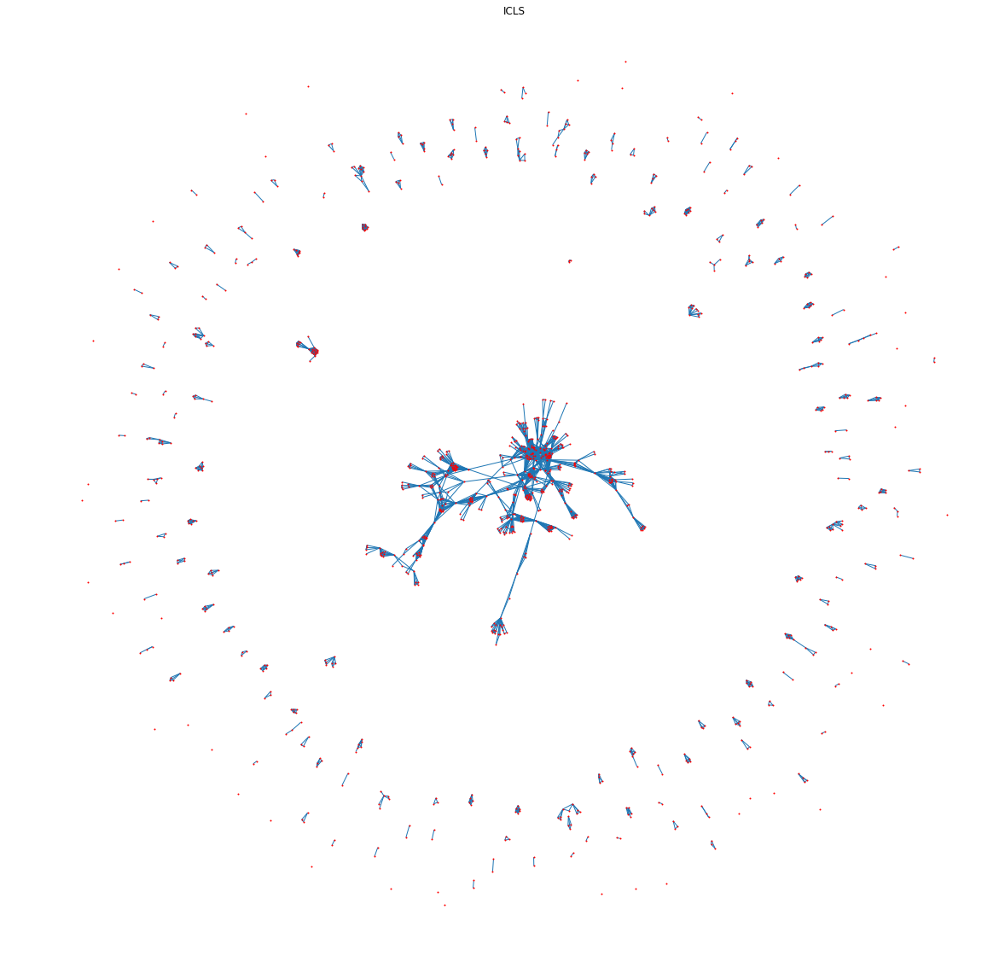

Density of the graph :  0.0054722715610815076
The largest component has  412 nodes accounting for 36.59 % of the nodes
The diameter of the largest component is 14
The clustering coeff of is 0.7657434909232406


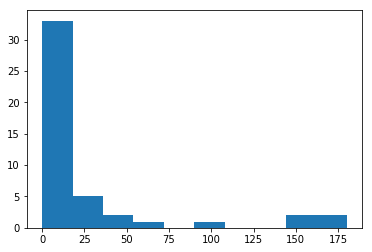

The average shortest path length in the main component is :  5.292348758651643
Attribute Assortativity coef: Country:  0.5000369449234375
Attribute Assortativity coef: Uni:  0.33141476122034563
1      41
2      53
3      35
4      21
5      22
6      10
7       8
8       1
9       3
10      2
11      1
19      1
24      1
43      1
412     1
dtype: int64


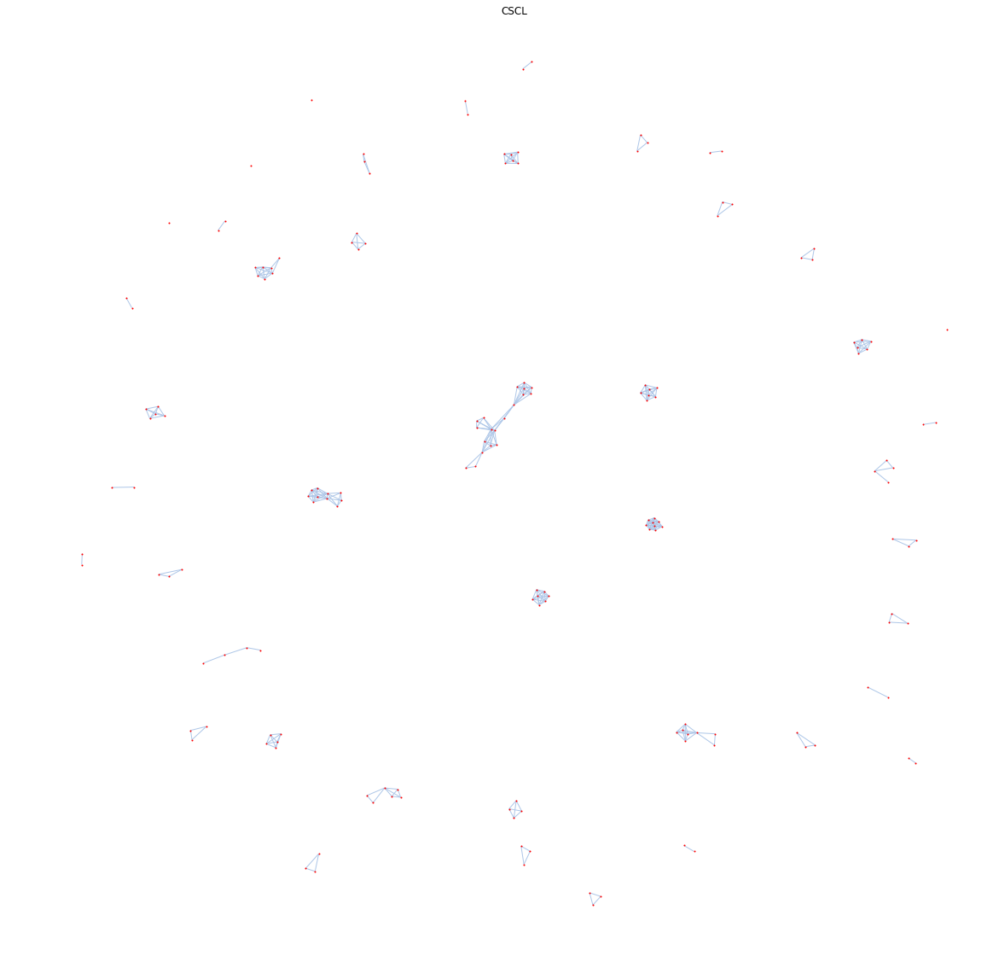

Density of the graph :  0.02157548057534615
The largest component has  19 nodes accounting for 10.98 % of the nodes
The diameter of the largest component is 4
The clustering coeff of is 0.7905128910909258


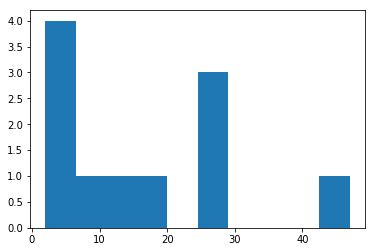

The average shortest path length in the main component is :  2.134502923976608
Attribute Assortativity coef: Country:  0.7521957022450582
Attribute Assortativity coef: Uni:  0.610344286920941
1      4
2     11
3     12
4      4
5      2
6      3
7      3
8      1
9      1
10     1
19     1
dtype: int64


In [123]:
for i, title in enumerate(['ICLS', 'CSCL']):
    year_assoc = associations[(associations.issued % 2 == i)]

    self_merge = pd.merge(year_assoc, year_assoc, on='file')
    self_merge = self_merge[self_merge.long_name_x != self_merge.long_name_y]

    #edges = self_merge[['long_name_x', 'long_name_y', 'issued_x']].copy()

    nodes = year_assoc[~year_assoc.long_name.duplicated()].reset_index(drop=True).reset_index()
    name_index = nodes.long_name.to_dict()
    name_index = {v: k for k, v in name_index.items()}

    self_merge['source'] = self_merge.long_name_x.map(name_index)
    self_merge['target'] = self_merge.long_name_y.map(name_index)

    adjacency = get_adjacency(nodes, self_merge)
    graph = nx.from_numpy_array(adjacency)
    
    plt.figure(figsize=(20, 20))
    plt.title(title)
    data = nodes.copy()
    #draw_map_plot(data, palette.as_hex()[i])


    embedding = nodes.apply(lambda x: [x.Lon, x.Lat], axis=1)
    nx.draw(graph,  #pos = embedding, 
                           edge_color=palette.as_hex()[i], node_size = 1)
    plt.show()   

    nx.set_node_attributes(graph, nodes.country.to_dict(), name='country')
    nx.set_node_attributes(graph, nodes.name.to_dict(), name='uni')
    nx.set_node_attributes(graph, nx.degree_centrality(graph), name='centrality')


    print('Density of the graph : ' , nx.density(graph))
    
    comp = list(nx.connected_components(graph))
    largest_comp = max(comp, key=len)
    percentage_lcc = len(largest_comp)/ graph.number_of_nodes() * 100
    print('The largest component has ',
          len(largest_comp), 'nodes',
          'accounting for %.2f'% percentage_lcc, 
          '% of the nodes')
    lcc = graph.subgraph(largest_comp)
    diameter = nx.diameter(lcc)
    print("The diameter of the largest component is", diameter)
    print("The clustering coeff of is",nx.average_clustering(graph))
    plt.hist(nx.degree_histogram(graph))
    plt.show()
    print("The average shortest path length in the main component is : " ,nx.average_shortest_path_length(lcc) )
    print('Attribute Assortativity coef: Country: ', nx.attribute_assortativity_coefficient(graph, 'country'))
    print('Attribute Assortativity coef: Uni: ', nx.attribute_assortativity_coefficient(graph, 'uni'))
    print(pd.Series([len(i) for i in comp]).value_counts().sort_index())

From the path length in the largest component we see that the core-cummunity (as given by collaboration) of CSCL seems to be much more close knit than the icls community. Looking at the previous graphs with separation by years this may partially be due to the many new participants in 2018's icls, but as 2016's icls also has a larger diameter, this might be an underlying pattern that could be confirmed with more data.

In [124]:
year_assoc = associations[(associations.issued % 2 == 1)]

self_merge = pd.merge(year_assoc, year_assoc, on='file')
self_merge = self_merge[self_merge.long_name_x != self_merge.long_name_y]

#edges = self_merge[['long_name_x', 'long_name_y', 'issued_x']].copy()

nodes = year_assoc[~year_assoc.long_name.duplicated()].reset_index(drop=True).reset_index()
name_index = nodes.long_name.to_dict()
name_index = {v: k for k, v in name_index.items()}

self_merge['source'] = self_merge.long_name_x.map(name_index)
self_merge['target'] = self_merge.long_name_y.map(name_index)

adjacency = get_adjacency(nodes, self_merge)
graph = nx.from_numpy_array(adjacency)


nx.set_node_attributes(graph, nodes.country.to_dict(), name='country')
nx.set_node_attributes(graph, nodes.name.to_dict(), name='uni')
nx.set_node_attributes(graph, nx.degree_centrality(graph), name='centrality')

graph=nx.relabel_nodes(graph, nodes.long_name.to_dict())
nx.set_edge_attributes(graph, keyword_dict, name='keywords')
component = list(nx.connected_components(graph))


In [125]:
for cluster in [c for c in component if len(c) > 99]:
    comp = comp = graph.subgraph(cluster)
    keywords = pd.Series(list(nx.get_edge_attributes(comp, 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()
    
    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=30, 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())
    
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud.png', bbox_inches='tight')
    plt.show()
    
    node_size = np.array(list(nx.betweenness_centrality(comp).values()))
    persons_of_interest = pd.DataFrame(list(comp.nodes)).copy()
    persons_of_interest['centrality'] = node_size

    persons_of_interest.centrality.quantile(.97)

    labels = persons_of_interest.sort_values(by='centrality', ascending=False).head(20)
    print(labels.set_index(0))
    
       
    plot_df = pd.DataFrame(nodes[nodes.long_name.isin(cluster)].groupby(['issued'])\
                           .country.value_counts()).rename(columns={'country':'count'}).reset_index()
    plot_df.pivot(index='issued', columns='country', values='count').plot(kind='bar', stacked=True, colormap=plt.cm.Spectral)
    plt.title('Distribution of country participation over the years')
    plt.legend(bbox_to_anchor=(1, 1))
    
    plt.show() 

In [126]:
colors = pd.Series({x: -1  for x in main_component.nodes})
colors = colors.reset_index()
colors[0] = colors['index'].map({ x: i+1 for i, c in enumerate(component)  for x in c if len(c) > 99})
colors = colors.fillna(2)

In [127]:
pos = nx.layout.spring_layout(main_component, seed=4)

In [128]:
node_size = np.array(list(nx.betweenness_centrality(main_component).values()))

In [129]:
colors[0].value_counts()

2.0    511
Name: 0, dtype: int64

   1  ||  2  ||  3  ||  4


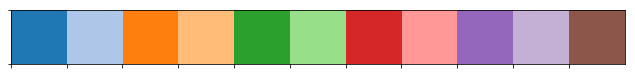

In [130]:
palette = sns.color_palette(palette='tab20', n_colors=11)#len(10)+1)

sns.palplot(palette)
print('  ', '  ||  '.join([str(i) for i in list(range(1, 4+1))]))

In [131]:
p = palette.as_hex()

In [132]:
col = colors[0].map({2:p[0], 4: p[6], 1:p[2]})

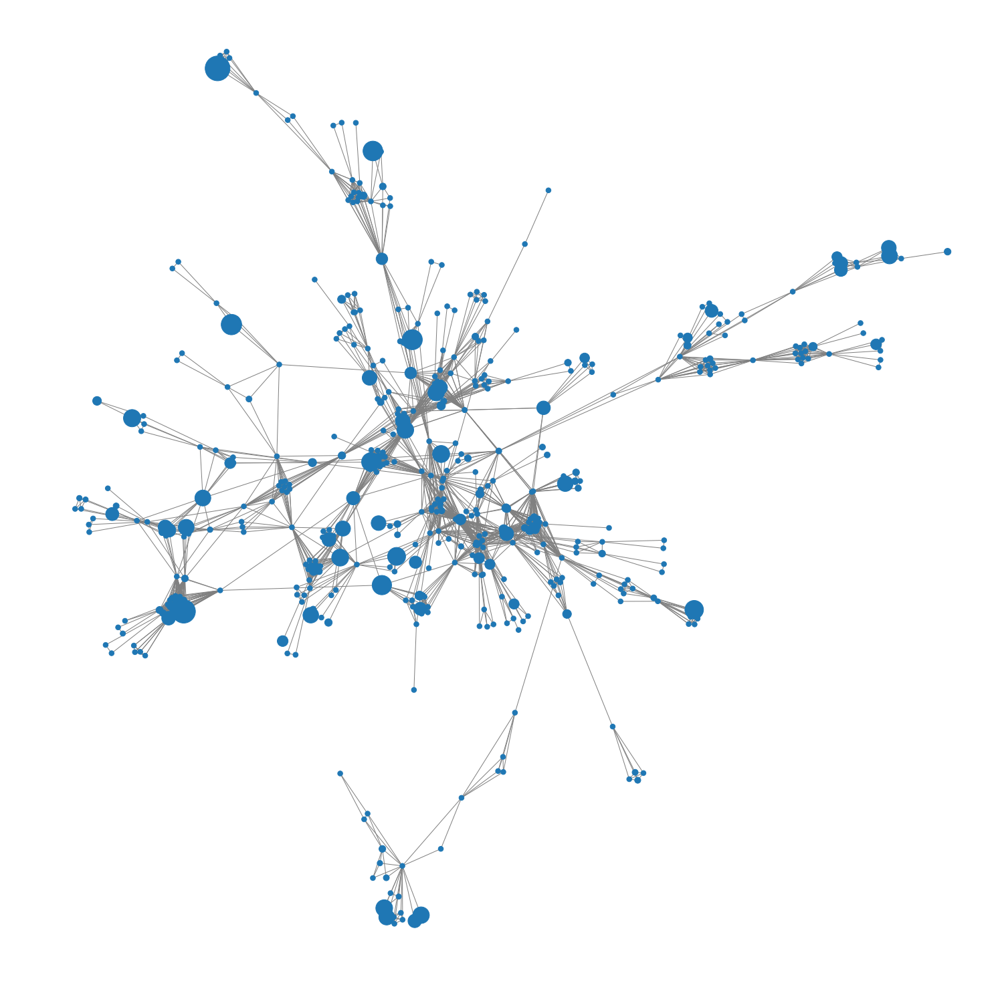

In [133]:
plt.figure(figsize=(20, 20))

nx.draw(main_component, pos=pos, 
        node_color=col.tolist(),
        #cmap=ListedColormap(palette.as_hex()),
        node_size=(node_size+node_size.mean())*6000,
        #labels=labels,
        edge_color='grey')
plt.savefig('figures/CSCL_componets')

In [134]:
ICLS_only = set(associations[associations.issued % 2 == 0].long_name.unique()) - set(associations[associations.issued % 2 == 1].long_name.unique())

In [135]:
colors[0] = colors['index'].map({ x: i+1 for i, c in enumerate(component)  for x in c if len(c) > 99})
colors.loc[colors['index'].isin(ICLS_only), 0] = 3
colors = colors.fillna(2)

In [136]:
colors[0].value_counts()

3.0    435
2.0     76
Name: 0, dtype: int64

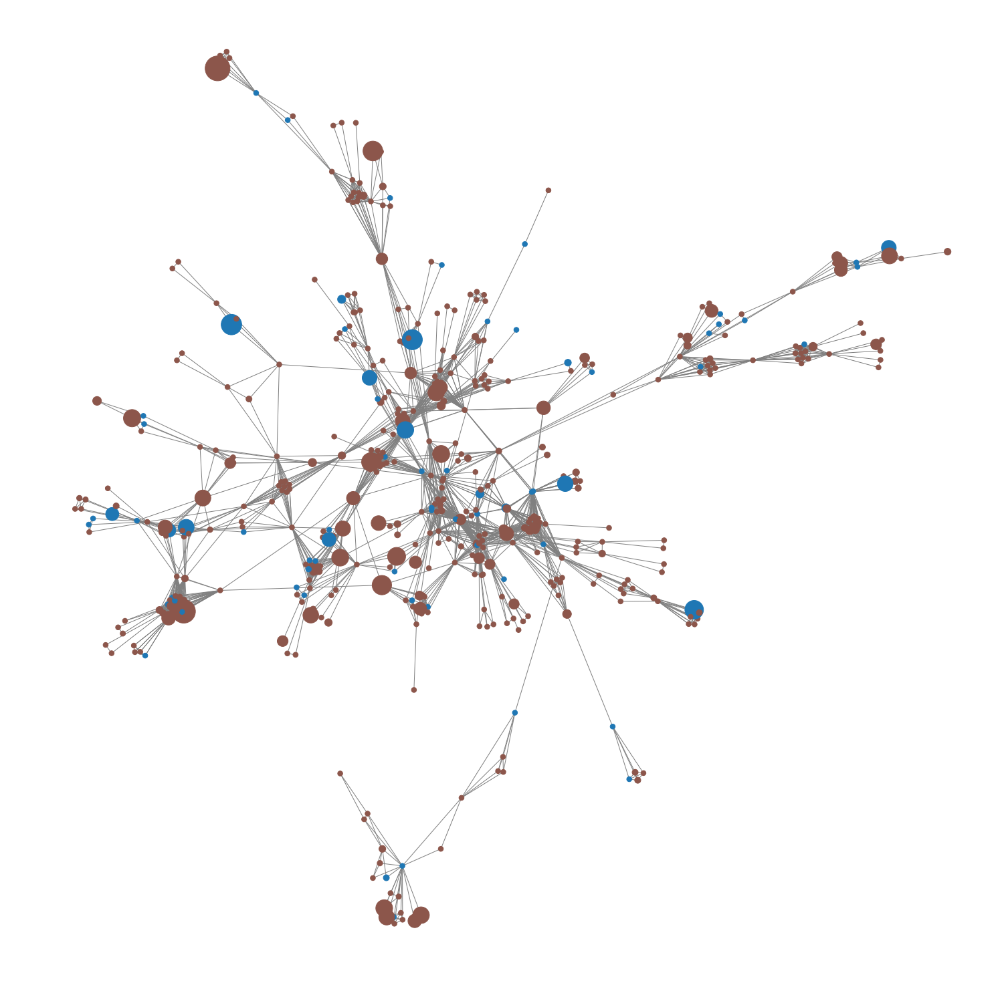

In [137]:
plt.figure(figsize=(20, 20))

nx.draw(main_component, pos=pos, 
        node_color=colors[0].tolist(),
        cmap=ListedColormap(palette.as_hex()),
        node_size=(node_size+node_size.mean())*6000,
        #labels=labels,
        edge_color='grey')

In [138]:
year_assoc = associations[(associations.issued % 2 == 0)]

self_merge = pd.merge(year_assoc, year_assoc, on='file')
self_merge = self_merge[self_merge.long_name_x != self_merge.long_name_y]

#edges = self_merge[['long_name_x', 'long_name_y', 'issued_x']].copy()

nodes = year_assoc[~year_assoc.long_name.duplicated()].reset_index(drop=True).reset_index()
name_index = nodes.long_name.to_dict()
name_index = {v: k for k, v in name_index.items()}

self_merge['source'] = self_merge.long_name_x.map(name_index)
self_merge['target'] = self_merge.long_name_y.map(name_index)

adjacency = get_adjacency(nodes, self_merge)
graph = nx.from_numpy_array(adjacency)


nx.set_node_attributes(graph, nodes.country.to_dict(), name='country')
nx.set_node_attributes(graph, nodes.name.to_dict(), name='uni')
nx.set_node_attributes(graph, nx.degree_centrality(graph), name='centrality')

graph=nx.relabel_nodes(graph, nodes.long_name.to_dict())
nx.set_edge_attributes(graph, keyword_dict, name='keywords')
component = list(nx.connected_components(graph))

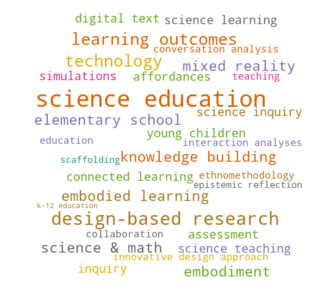

                        centrality
0                                 
Wallace, Scott R          0.192186
Elby, Andrew              0.178743
Joseph, Joseph Krajcik    0.167943
Ramey, Kay E              0.144986
Sedas, Mishael            0.139632
Bhaduri, Srinjita         0.136229
Ma, Guanzhong             0.134057
Rico-Beck, Laura          0.129613
Lee, Victor               0.119461
Ferrari, Giulia           0.114801
Pitt, Caroline            0.105917
Lindgren, Robb            0.101884
Pinkard, Nichole          0.101573
Vieira, Camilo            0.097209
Gresalfi, Melissa         0.094832
Manz, Eve                 0.094047
Anderson, Eleanor         0.094047
Finch, Lila               0.088398
Tofel-Grehl, Colby        0.084012
Fortus, David             0.084012


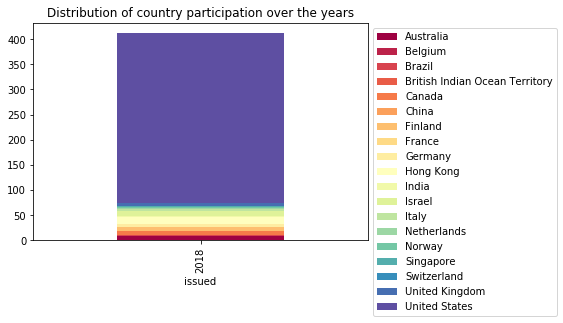

spectral clustering
3    129
4     70
0     57
8     44
9     30
2     24
5     22
6     14
7     13
1      9
dtype: int64


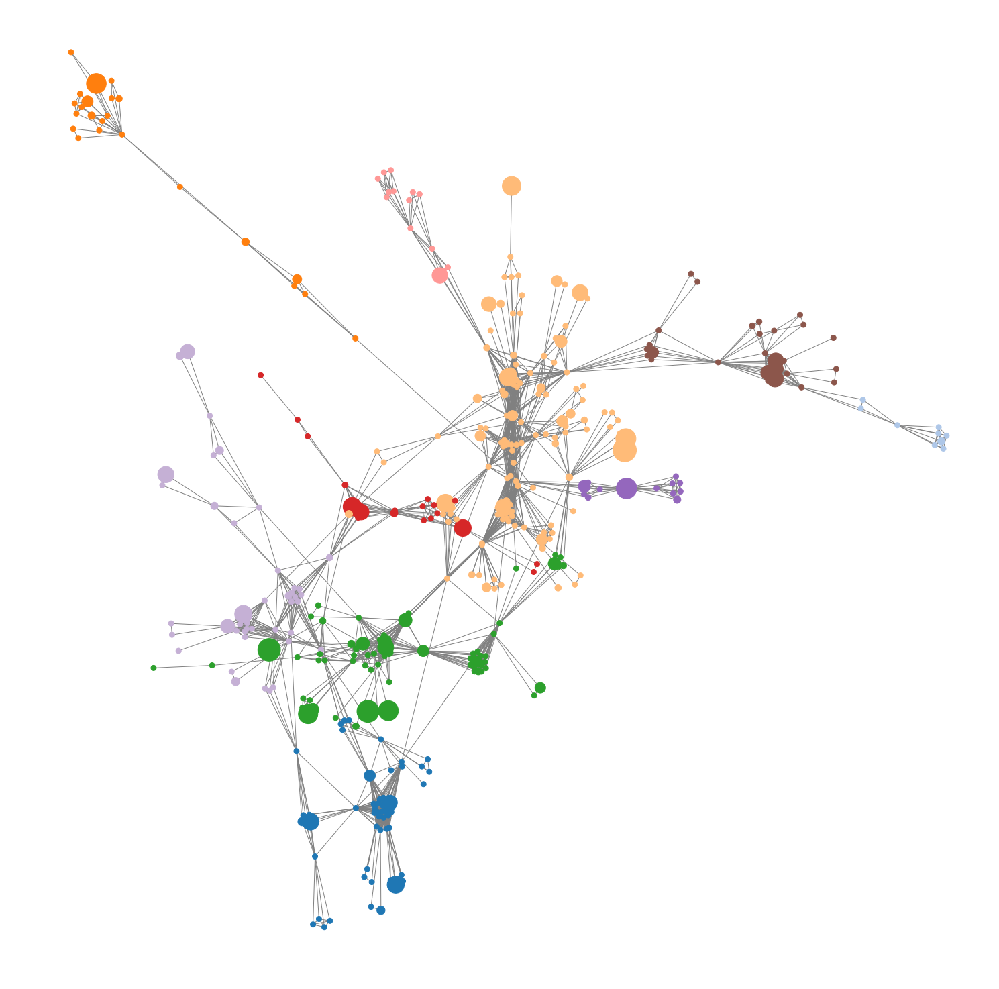

In [139]:
for cluster in [c for c in component if len(c) > 99]:
    comp = graph.subgraph(cluster)
    keywords = pd.Series(list(nx.get_edge_attributes(comp, 'keywords').values()))
    keywords = pd.Series([i for j in keywords[
        ~keywords.map(lambda x : ''.join(x)).duplicated()].tolist() for i in j]).value_counts()
    
    wordcloud = WordCloud(background_color="white", contour_width=3, width=500, height=500, max_words=30, 
                      min_font_size=1, colormap="Dark2")
    wordcloud.generate_from_frequencies(keywords.to_dict())
    
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud.png', bbox_inches='tight')
    plt.show()
    
    node_size = np.array(list(nx.betweenness_centrality(comp).values()))
    persons_of_interest = pd.DataFrame(list(comp.nodes)).copy()
    persons_of_interest['centrality'] = node_size

    persons_of_interest.centrality.quantile(.97)

    labels = persons_of_interest.sort_values(by='centrality', ascending=False).head(20)
    print(labels.set_index(0))
    
       
    plot_df = pd.DataFrame(nodes[nodes.long_name.isin(cluster)].groupby(['issued'])\
                           .country.value_counts()).rename(columns={'country':'count'}).reset_index()
    plot_df.pivot(index='issued', columns='country', values='count').plot(kind='bar', stacked=True, colormap=plt.cm.Spectral)
    plt.title('Distribution of country participation over the years')
    plt.legend(bbox_to_anchor=(1, 1))
    
    plt.show() 
    from sklearn.cluster import SpectralClustering

    # Cluster
    sc = SpectralClustering(n_cluster, affinity='precomputed', n_init=100)
    sc.fit(nx.adj_matrix(comp))

    # Compare ground-truth and clustering-results
    print('spectral clustering')
    print(pd.Series(sc.labels_).value_counts())
    
    plt.figure(figsize=(20, 20))

    nx.draw(comp, node_color=sc.labels_,#node_color=node_colors, 
                       cmap=ListedColormap(palette.as_hex()),
                       node_size=(node_size+node_size.mean())*6000,
                       #labels=labels,
               edge_color='grey',
              )
    plt.show()

## Re-examining 2018: how do nodes join?

In [140]:
previous_participation = set(associations[~associations.issued.isin([2018])].long_name.tolist())

year_assoc = associations[(associations.Lon.notna()) & (associations.issued == 2018)].copy()

year_assoc['prev'] = 0
year_assoc.loc[year_assoc.long_name.isin(previous_participation),'prev'] = 1

self_merge = pd.merge(year_assoc, year_assoc, on='file')
self_merge = self_merge[(self_merge.long_name_x != self_merge.long_name_y)]


nodes = year_assoc[~year_assoc.long_name.duplicated()].reset_index(drop=True).reset_index()
nodes = nodes[nodes.Lon.notna()]

name_index = nodes.long_name.to_dict()
name_index = {v: k for k, v in name_index.items()}



self_merge['source'] = self_merge.long_name_x.map(name_index)
self_merge['target'] = self_merge.long_name_y.map(name_index)


adjacency = get_adjacency(nodes, self_merge)
graph = nx.from_numpy_array(adjacency)

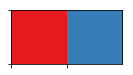

In [141]:
palette = sns.color_palette(palette='Set1', n_colors=2)

sns.palplot(palette)

We see that some of the new nodes joining in 2018 partly attach to people who already have participated in the conference in pervious years, while others join independently.

In red we have ned nodes, blue for old nodes.

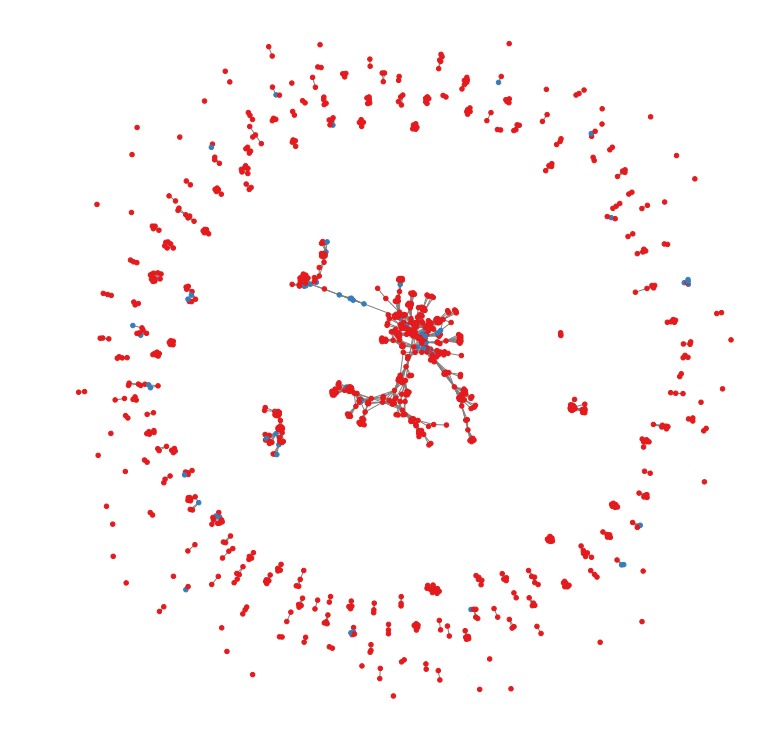

In [142]:
plt.figure(figsize=(10, 10))
nx.draw_spring(graph, cmap=ListedColormap(palette.as_hex()), 
               node_color=nodes.prev.tolist(), width = 1,  edge_color='grey', node_size=[20, 20])

We now analyze these mentors and mentees:

In [143]:
mentoring_connections = self_merge[['long_name_x', 'long_name_y', 'prev_x', 
                                    'prev_y', 'name_x', 'name_y', 'file',
                                   'country_x', 'country_y']]

mentees = mentoring_connections[(mentoring_connections.prev_x != mentoring_connections.prev_y) & 
                      (mentoring_connections.prev_x == 0)]

Number of people that co-authored a paper with somebody who already participated in the conference in previous years:

In [144]:
mentees.long_name_y.drop_duplicates().shape

(62,)

And the institutions they are affiliated with:

In [145]:
mentees[~mentees[['name_y', 'file']].duplicated()].name_y.value_counts().head(10)

Indiana University at Bloomington        9
University of Hong Kong                  9
Ruhr-University Bochum                   7
University of California, Berkeley       7
Stanford University                      7
University of California, Los Angeles    5
New York University                      5
University of Pennsylvania               5
Northwestern University                  4
Shizuoka University                      4
Name: name_y, dtype: int64

In [146]:
mentees[~mentees[['country_y', 'file']].duplicated()].country_y.value_counts().head(10)

United States     53
Hong Kong          9
Germany            8
Japan              4
Australia          3
Canada             3
Norway             2
United Kingdom     2
Netherlands        1
Switzerland        1
Name: country_y, dtype: int64

The corresponding mentors:

In [147]:
mentees[~mentees[['long_name_x', 'file']].duplicated()].long_name_x.value_counts().head(10)

Davis, Bria         3
Aleven, Vincent     3
Humburg, Megan      3
Dahn, Maggie        3
Thompson, Naomi     3
Horn, Mike          3
Moczek, Armin       3
Peppler, Kylie A    3
Ramey, Kay E        3
Tu, Xintian         3
Name: long_name_x, dtype: int64

Looking at lone wolf participants:

In [148]:
def get_loners(mentoring_connections):
    loner_mask = (mentoring_connections.groupby('file').prev_x.sum() + mentoring_connections.groupby('file').prev_y.sum())
    loner_mask = loner_mask[loner_mask == 0].index.tolist()
    return mentoring_connections[mentoring_connections.file.isin(loner_mask)]

In [149]:
lone_wolfs = get_loners(mentoring_connections)

In [150]:
lone_wolfs.long_name_y.drop_duplicates().shape

(773,)

In [151]:
lone_wolfs[~lone_wolfs[['long_name_x', 'file']].duplicated()].long_name_x.value_counts().head()

Polman, Joseph L       5
Grover, Shuchi         4
Silver, Cindy Hmelo    4
Y., Jasmine            4
Chinn, Clark           4
Name: long_name_x, dtype: int64

Here comes in the increase of americans in 2018!

In [152]:
lone_wolfs[~lone_wolfs[['name_x', 'file']].duplicated()].name_x.value_counts().head()

University of Colorado at Boulder    19
University of Wisconsin - Madison    15
University of Washington             14
Vanderbilt University                11
Stanford University                  11
Name: name_x, dtype: int64

In [153]:
lone_wolfs[~lone_wolfs[['country_x', 'file']].duplicated()].country_x.value_counts().head(10)

United States     210
Germany            18
Israel             13
Canada             10
United Kingdom      9
Australia           5
Hong Kong           5
Finland             5
India               4
Singapore           3
Name: country_x, dtype: int64

We should also consider the number of papers, not only the number of participants:

In [154]:
mentees.file.unique().shape

(86,)

In [155]:
lone_wolfs.file.unique().shape

(273,)

In [156]:
mentoring_connections.file.unique().shape

(366,)

The number of papers written uniquely by veterans is then:

In [157]:
mentoring_connections.file.unique().shape[0] - (mentees.file.unique().shape[0]+lone_wolfs.file.unique().shape[0])

7

**We take this idea and apply it to the previous years to get a point of comparisoon:**

#### For 2017

In [158]:
previous_participation = set(associations[~associations.issued.isin([2018, 2017])].long_name.tolist())

year_assoc = associations[(associations.Lon.notna()) & (associations.issued == 2017)].copy()

year_assoc['prev'] = 0
year_assoc.loc[year_assoc.long_name.isin(previous_participation),'prev'] = 1

self_merge = pd.merge(year_assoc, year_assoc, on='file')
self_merge = self_merge[(self_merge.long_name_x != self_merge.long_name_y)]

In [159]:
mentoring_connections = self_merge[['long_name_x', 'long_name_y', 'prev_x', 
                                    'prev_y', 'name_x', 'name_y', 'file',
                                   'country_x', 'country_y']]

mentees = mentoring_connections[(mentoring_connections.prev_x != mentoring_connections.prev_y) & 
                      (mentoring_connections.prev_x == 0)]

Number of people that co-authored a paper with somebody who already participated in the conference in previous years:

In [160]:
mentees.long_name_y.drop_duplicates().shape

(0,)

And the institutions they are affiliated with:

In [161]:
mentees[~mentees[['name_y', 'file']].duplicated()].name_y.value_counts().head(10)

Series([], Name: name_y, dtype: int64)

In [162]:
mentees[~mentees[['country_y', 'file']].duplicated()].country_y.value_counts().head(10)

Series([], Name: country_y, dtype: int64)

We see that in 2017, the number of new participants is much more consistend with numbers of incomming phd et. comming into the field.

Again, looking at lone wolf participants:

In [163]:
lone_wolfs = lone_wolfs = get_loners(mentoring_connections)
lone_wolfs.long_name_y.drop_duplicates().shape

(0,)

We also see much fewer lone wolf participants:

In [164]:
lone_wolfs[~lone_wolfs[['name_x', 'file']].duplicated()].name_x.value_counts().head()

Series([], Name: name_x, dtype: int64)

In [165]:
lone_wolfs[~lone_wolfs[['country_x', 'file']].duplicated()].country_x.value_counts().head(10)

Series([], Name: country_x, dtype: int64)

We should also consider the number of papers, not only the number of participants:

In [166]:
mentees.file.unique().shape

(0,)

In [167]:
lone_wolfs.file.unique().shape

(0,)

In [168]:
mentoring_connections.file.unique().shape

(0,)

The number of papers written uniquely by veterans is then:

In [169]:
mentoring_connections.file.unique().shape[0] - (mentees.file.unique().shape[0]+lone_wolfs.file.unique().shape[0])

0

#### For 2016

In [170]:
previous_participation = set(associations[~associations.issued.isin([2018, 2017, 2016])].long_name.tolist())

year_assoc = associations[(associations.Lon.notna()) & (associations.issued == 2016)].copy()

year_assoc['prev'] = 0
year_assoc.loc[year_assoc.long_name.isin(previous_participation),'prev'] = 1

self_merge = pd.merge(year_assoc, year_assoc, on='file')
self_merge = self_merge[(self_merge.long_name_x != self_merge.long_name_y)]

In [171]:
mentoring_connections = self_merge[['long_name_x', 'long_name_y', 'prev_x', 
                                    'prev_y', 'name_x', 'name_y', 'file',
                                   'country_x', 'country_y']]

mentees = mentoring_connections[(mentoring_connections.prev_x != mentoring_connections.prev_y) & 
                      (mentoring_connections.prev_x == 0)]

Number of people that co-authored a paper with somebody who already participated in the conference in previous years:

In [172]:
mentees.long_name_y.drop_duplicates().shape

(0,)

And the institutions they are affiliated with:

In [173]:
mentees[~mentees[['name_y', 'file']].duplicated()].name_y.value_counts().head(10)

Series([], Name: name_y, dtype: int64)

In [174]:
mentees[~mentees[['country_y', 'file']].duplicated()].country_y.value_counts().head(10)

Series([], Name: country_y, dtype: int64)

We see that in 2017, the number of new participants is much more consistend with numbers of incomming phd et. comming into the field.

Again, looking at lone wolf participants:

In [175]:
lone_wolfs = get_loners(mentoring_connections)
lone_wolfs.long_name_y.drop_duplicates().shape

(0,)

We also see much fewer lone wolf participants:

In [176]:
lone_wolfs[~lone_wolfs[['name_x', 'file']].duplicated()].name_x.value_counts().head()

Series([], Name: name_x, dtype: int64)

In [177]:
lone_wolfs[~lone_wolfs[['country_x', 'file']].duplicated()].country_x.value_counts().head(10)

Series([], Name: country_x, dtype: int64)

We should also consider the number of papers, not only the number of participants:

In [178]:
mentees.file.unique().shape

(0,)

In [179]:
lone_wolfs.file.unique().shape

(0,)

In [180]:
mentoring_connections.file.unique().shape

(0,)

The number of papers written uniquely by veterans is then:

In [181]:
mentoring_connections.file.unique().shape[0] - (mentees.file.unique().shape[0]+lone_wolfs.file.unique().shape[0])

0